<a href="https://colab.research.google.com/github/vpurushoth18/GANs/blob/main/GAN_pytorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## GAN starter code
Corresponding tutorial: [https://youtu.be/_pIMdDWK5sc](https://youtu.be/_pIMdDWK5sc)

In [ ]:
!pip install pytorch-lightning

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.1/823.1 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 117.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 61.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 67.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 961.5/961.5 kB 47.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-

In [ ]:
import os

import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import MNIST

import matplotlib.pyplot as plt

import pytorch_lightning as pl


random_seed = 42
torch.manual_seed(random_seed)

BATCH_SIZE=128
AVAIL_GPUS = min(1, torch.cuda.device_count())
NUM_WORKERS=int(os.cpu_count() / 2)

In [ ]:
class MNISTDataModule(pl.LightningDataModule):
    def __init__(self, data_dir="./data",
                 batch_size=BATCH_SIZE, num_workers=NUM_WORKERS):
        super().__init__()
        self.data_dir = data_dir
        self.batch_size = batch_size
        self.num_workers = num_workers

        self.transform = transforms.Compose(
            [
                transforms.ToTensor(),
                transforms.Normalize((0.1307,), (0.3081,)),
            ]
        )

    def prepare_data(self):
        MNIST(self.data_dir, train=True, download=True)
        MNIST(self.data_dir, train=False, download=True)

    def setup(self, stage=None):
        # Assign train/val datasets
        if stage == "fit" or stage is None:
            mnist_full = MNIST(self.data_dir, train=True, transform=self.transform)
            self.mnist_train, self.mnist_val = random_split(mnist_full, [55000, 5000])

        # Assign test dataset
        if stage == "test" or stage is None:
            self.mnist_test = MNIST(self.data_dir, train=False, transform=self.transform)

    def train_dataloader(self):
        return DataLoader(self.mnist_train, batch_size=self.batch_size, num_workers=self.num_workers)

    def val_dataloader(self):
        return DataLoader(self.mnist_val, batch_size=self.batch_size, num_workers=self.num_workers)

    def test_dataloader(self):
        return DataLoader(self.mnist_test, batch_size=self.batch_size, num_workers=self.num_workers)

In [ ]:
# Detective: fake or no fake -> 1 output [0, 1]
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        # Simple CNN
        self.conv1 = nn.Conv2d(1, 10, kernel_size=5)
        self.conv2 = nn.Conv2d(10, 20, kernel_size=5)
        self.conv2_drop = nn.Dropout2d()
        self.fc1 = nn.Linear(320, 50)
        self.fc2 = nn.Linear(50, 1)

    def forward(self, x):
        x = F.relu(F.max_pool2d(self.conv1(x), 2))
        x = F.relu(F.max_pool2d(self.conv2_drop(self.conv2(x)), 2))
        # Flatten the tensor so it can be fed into the FC layers
        x = x.view(-1, 320)
        x = F.relu(self.fc1(x))
        x = F.dropout(x, training=self.training)
        x = self.fc2(x)
        return torch.sigmoid(x)

In [ ]:
# Generate Fake Data: output like real data [1, 28, 28] and values -1, 1
class Generator(nn.Module):
    def __init__(self, latent_dim):
        super().__init__()
        self.lin1 = nn.Linear(latent_dim, 7*7*64)  # [n, 256, 7, 7]
        self.ct1 = nn.ConvTranspose2d(64, 32, 4, stride=2) # [n, 64, 16, 16]
        self.ct2 = nn.ConvTranspose2d(32, 16, 4, stride=2) # [n, 16, 34, 34]
        self.conv = nn.Conv2d(16, 1, kernel_size=7)  # [n, 1, 28, 28]


    def forward(self, x):
        # Pass latent space input into linear layer and reshape
        x = self.lin1(x)
        x = F.relu(x)
        x = x.view(-1, 64, 7, 7)  #256

        # Upsample (transposed conv) 16x16 (64 feature maps)
        x = self.ct1(x)
        x = F.relu(x)

        # Upsample to 34x34 (16 feature maps)
        x = self.ct2(x)
        x = F.relu(x)

        # Convolution to 28x28 (1 feature map)
        return self.conv(x)

In [ ]:
# TODO: GAN
class GAN(pl.LightningModule):
  def __init__(self, latent_dim=100, lr=0.0002):
    super().__init__()
    self.save_hyperparameters()
    self.generator = Generator(latent_dim=self.hparams.latent_dim)
    self.discriminator = Discriminator()

    self.validation_z = torch.randn(6, self.hparams.latent_dim)

    self.automatic_optimization = False

  def forward(self, z):
    return self.generator(z)

  def adversarial_loss(self, y_hat, y):
    return F.binary_cross_entropy(y_hat, y)

  # def training_step(self, batch, batch_idx, optimizer_idx):
  #   real_imgs, _ = batch

  #   z = torch.randn(real_imgs.shape[0], self.hparams.latent_dim)
  #   z = z.type_as(real_imgs)

  #   #train generator:
  #   if optimizer_idx == 0:
  #     #generate images
  #     fake_imgs = self(z)
  #     y_hat = self.discriminator(fake_imgs)
  #     y = torch.ones(real_imgs.size(0), 1)
  #     y = y.type_as(real_imgs)

  #     g_loss = self.adversarial_loss(y_hat, y)

  #     log_dict = {'g_loss': g_loss}
  #     return {'loss': g_loss, 'log': log_dict}

  #   if optimizer_idx == 1:
  #     #train discriminator

  #     y_hat_real = self.discriminator(real_imgs)
  #     y_real = torch.ones(real_imgs.size(0), 1)
  #     y_real = y_real.type_as(real_imgs)

  #     real_loss = self.adversarial_loss(y_hat_real, y)

  #     y_hat_fake = self.discriminator(self(z).detach())
  #     y_fake = torch.zeros(real_imgs.size(0), 1)
  #     y_fake = y_fake.type_as(real_imgs)

  #     fake_loss = self.adversarial_loss(y_hat_fake, y_fake)

  #     d_loss = (real_loss + fake_loss) / 2
  #     log_dict = {'d_loss': d_loss}
  #     return {'loss': d_loss, "progress_bar":log_dict, 'log': log_dict}

  def training_step(self, batch, batch_idx):
        real_imgs, _ = batch
        z = torch.randn(real_imgs.shape[0], self.hparams.latent_dim).type_as(real_imgs)

        opt_g, opt_d = self.optimizers()

        # === Train Generator ===
        fake_imgs = self(z)
        y_fake = torch.ones(real_imgs.size(0), 1).type_as(real_imgs)

        pred_fake = self.discriminator(fake_imgs)
        # pred_fake = self.discriminator(fake_imgs)
        g_loss = F.binary_cross_entropy(pred_fake, y_fake)

        opt_g.zero_grad()
        self.manual_backward(g_loss)
        opt_g.step()

        # === Train Discriminator ===
        y_real = torch.ones(real_imgs.size(0), 1).type_as(real_imgs)
        y_fake = torch.zeros(real_imgs.size(0), 1).type_as(real_imgs)

        pred_real = self.discriminator(real_imgs)
        loss_real = F.binary_cross_entropy(pred_real, y_real)

        pred_fake = self.discriminator(fake_imgs.detach())
        loss_fake = F.binary_cross_entropy(pred_fake, y_fake)

        d_loss = (loss_real + loss_fake) / 2

        opt_d.zero_grad()
        self.manual_backward(d_loss)
        opt_d.step()

        # Logging
        self.log("g_loss", g_loss, prog_bar=True)
        self.log("d_loss", d_loss, prog_bar=True)





  def configure_optimizers(self):
    lr = self.hparams.lr
    opt_g = torch.optim.Adam(self.generator.parameters(), lr=lr)
    opt_d = torch.optim.Adam(self.discriminator.parameters(), lr=lr)
    return [opt_g, opt_d], []

  def plot_imgs(self):
    z = self.validation_z.type_as(self.generator.lin1.weight)
    sample_imgs = self(z).cpu()

    print('epoch', self.current_epoch)
    fig = plt.figure()
    for i in range(sample_imgs.size(0)):
      plt.subplot(2, 3, i+1)
      plt.tight_layout()
      plt.imshow(sample_imgs.detach()[i,0,:,:], cmap='gray_r', interpolation='none')
      plt.title("Generated Data")
      plt.xticks([])
      plt.yticks([])
    plt.show()

  def on_train_epoch_end(self):
     self.plot_imgs()





In [ ]:
dm = MNISTDataModule()
model = GAN()
# trainer = pl.Trainer(gpus=AVAIL_GPUS, max_epochs=5, progress_bar_refresh_rate=20)
# trainer.fit(model, dm)

epoch 0


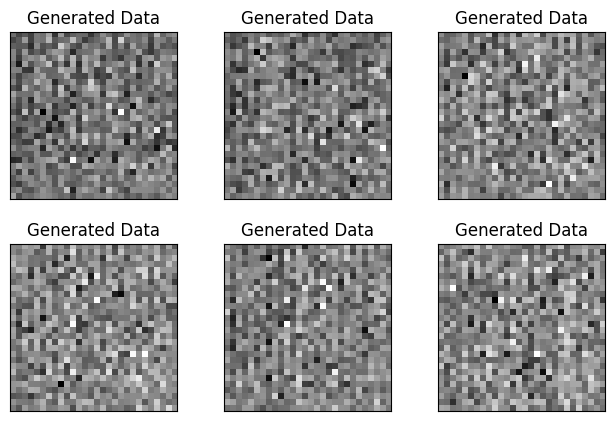

In [ ]:
model.plot_imgs()

INFO:pytorch_lightning.utilities.rank_zero:Using default `ModelCheckpoint`. Consider installing `litmodels` package to enable `LitModelCheckpoint` for automatic upload to the Lightning model registry.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/trainer/configuration_validator.py:68: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
100%|██████████| 9.91M/9.91M [00:00<00:00, 13.4MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 482kB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 4.44MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 8.92MB/s]
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type        

Training: |          | 0/? [00:00<?, ?it/s]

epoch 0


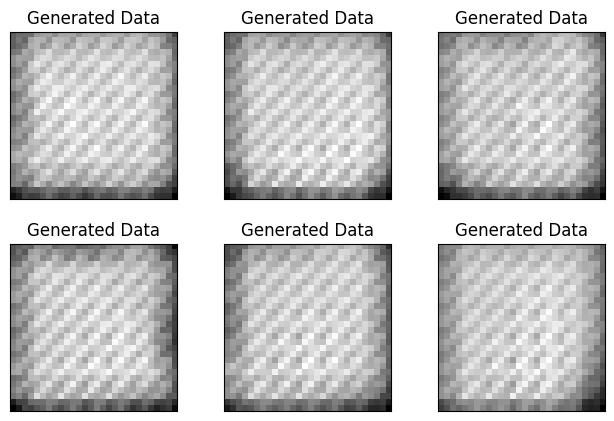

epoch 1


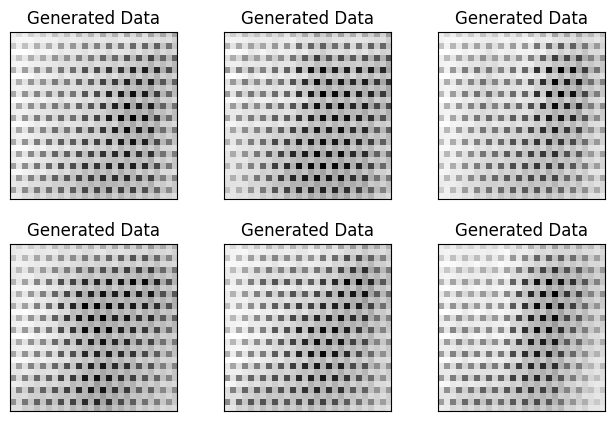

epoch 2


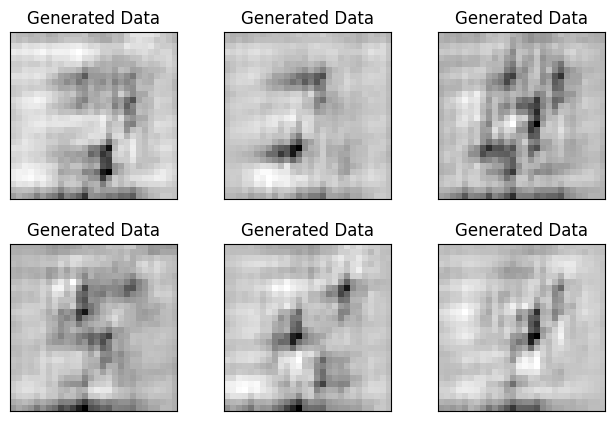

epoch 3


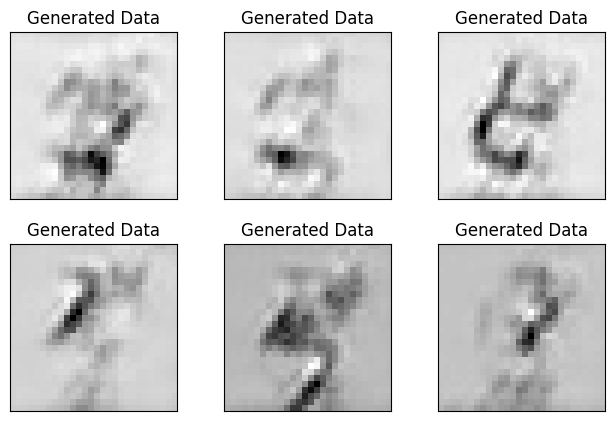

epoch 4


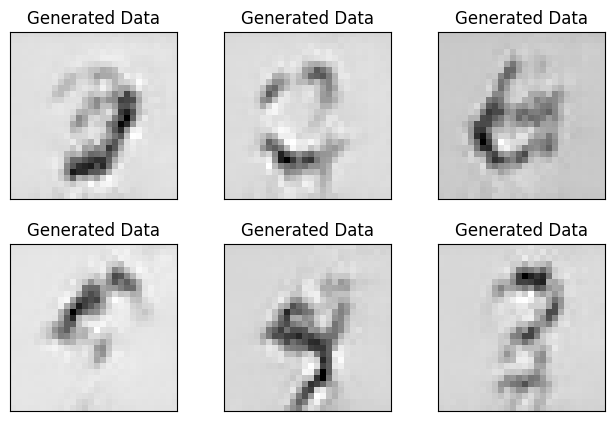

epoch 5


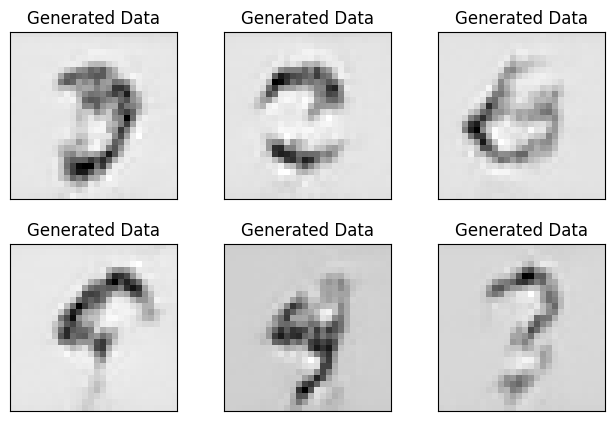

epoch 6


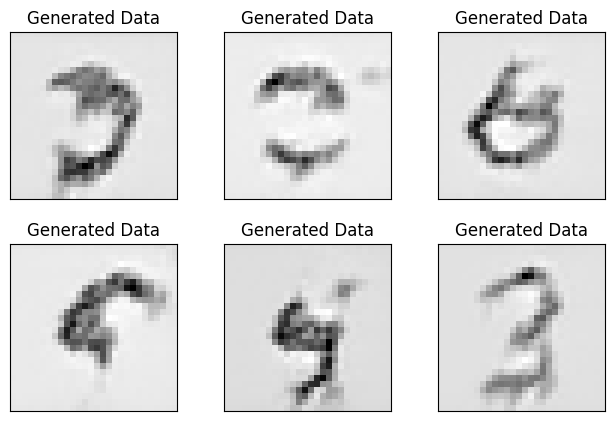

epoch 7


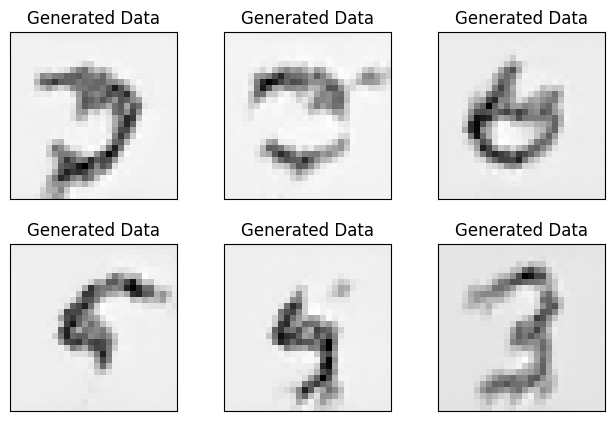

epoch 8


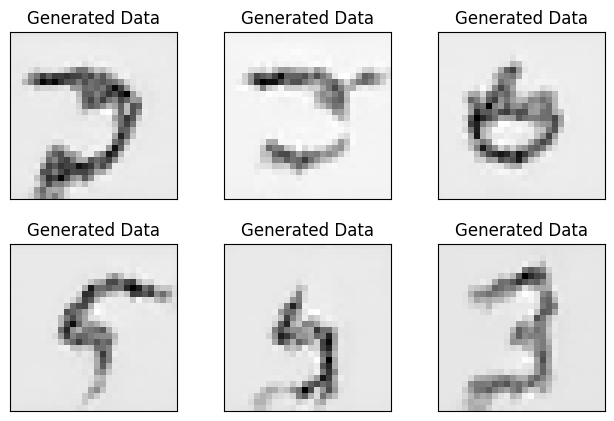

epoch 9


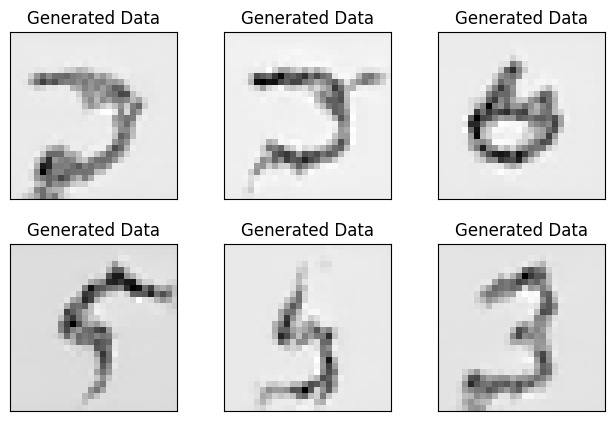

epoch 10


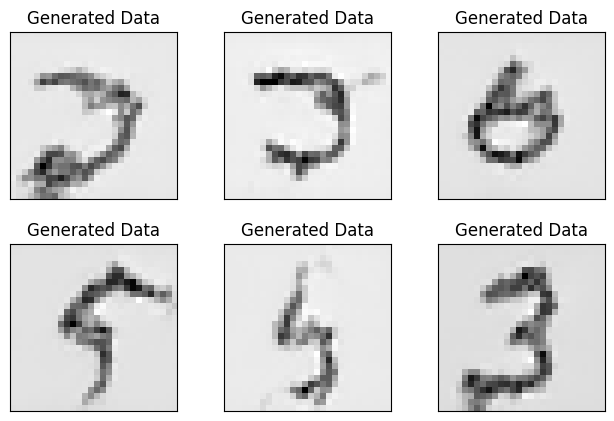

epoch 11


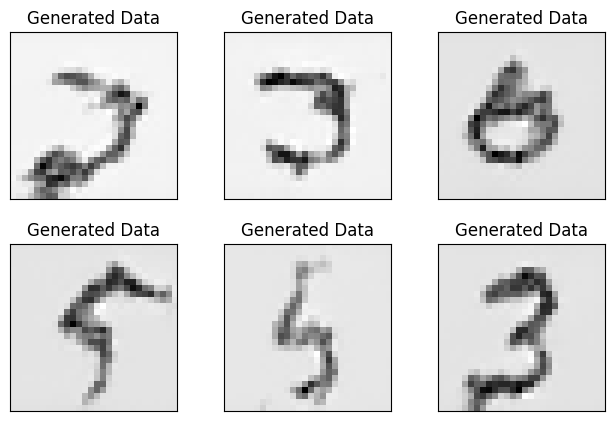

epoch 12


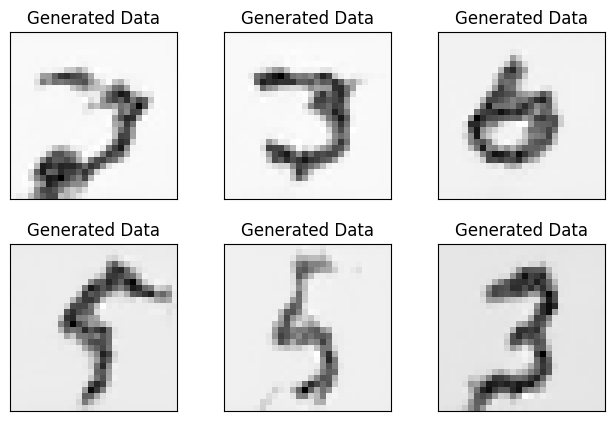

epoch 13


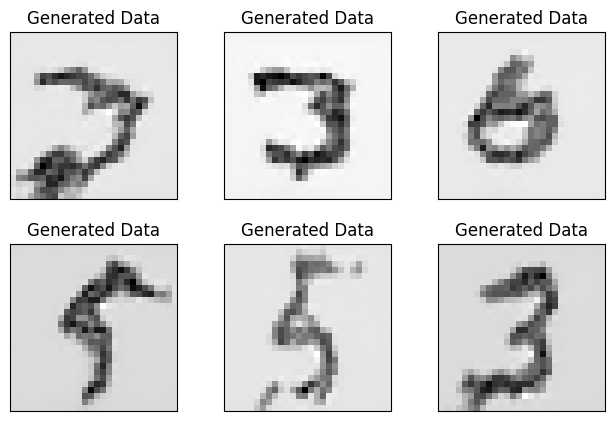

epoch 14


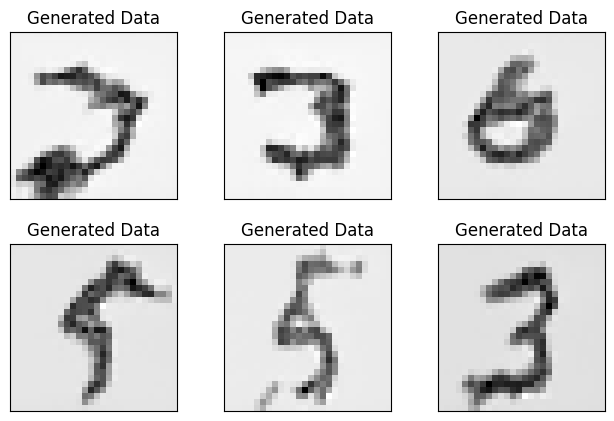

epoch 15


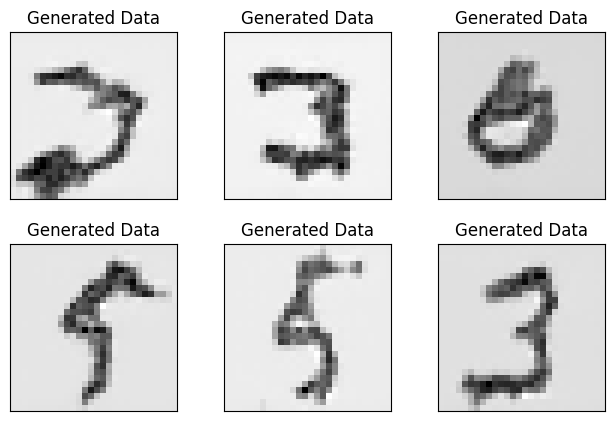

epoch 16


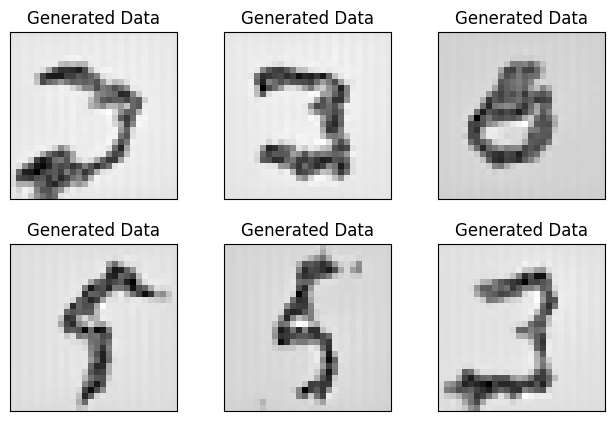

epoch 17


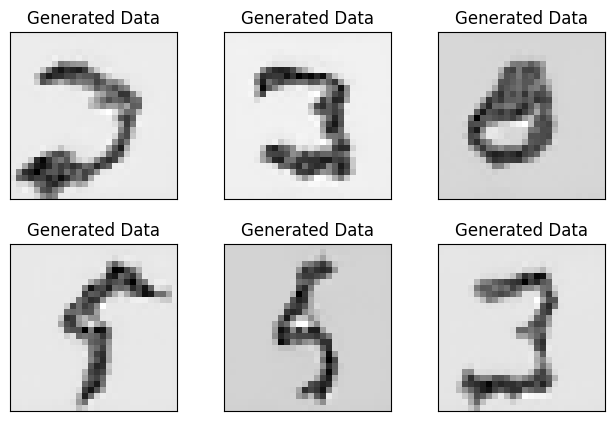

epoch 18


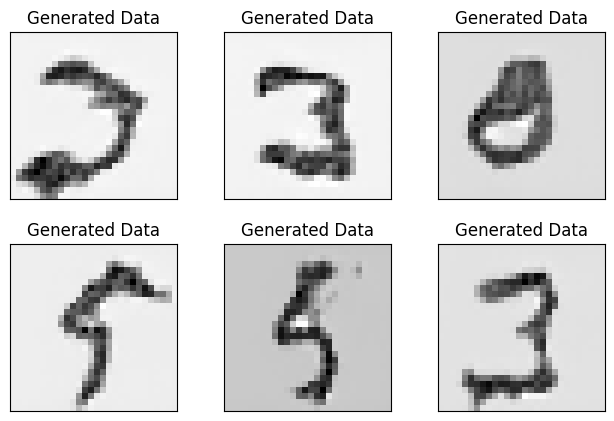

epoch 19


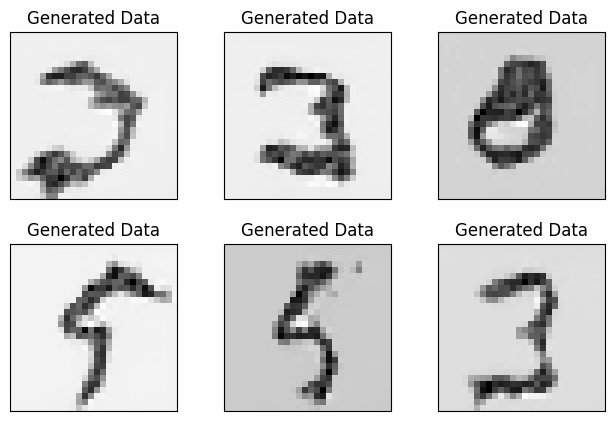

epoch 20


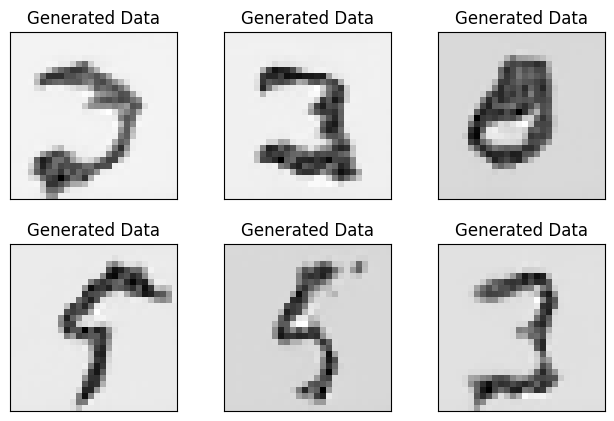

epoch 21


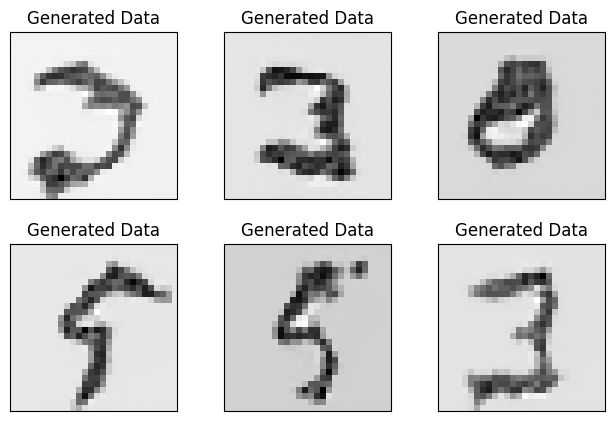

epoch 22


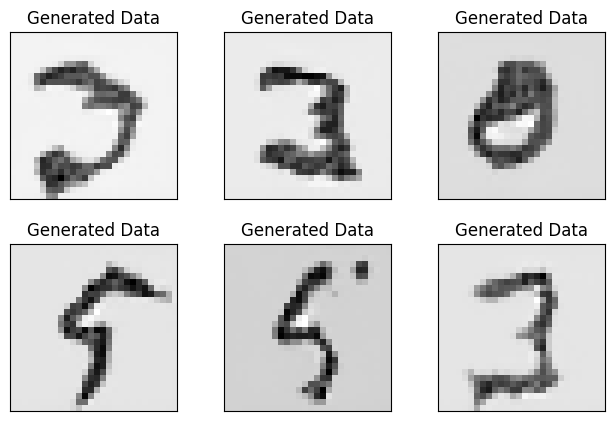

epoch 23


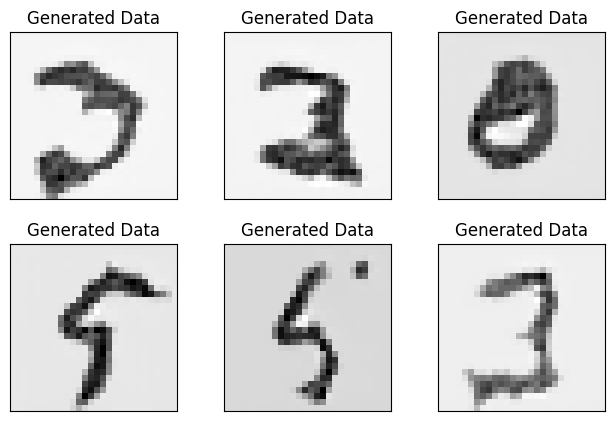

epoch 24


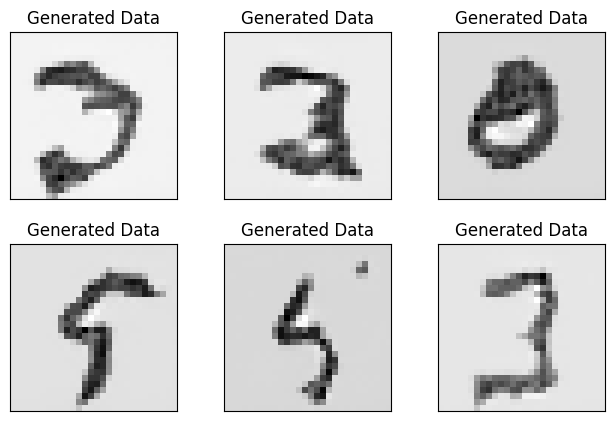

epoch 25


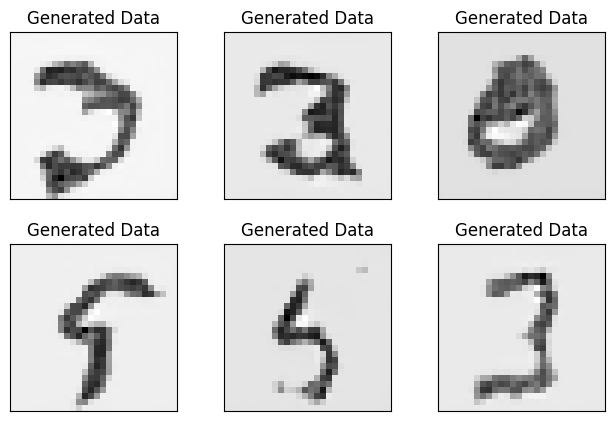

epoch 26


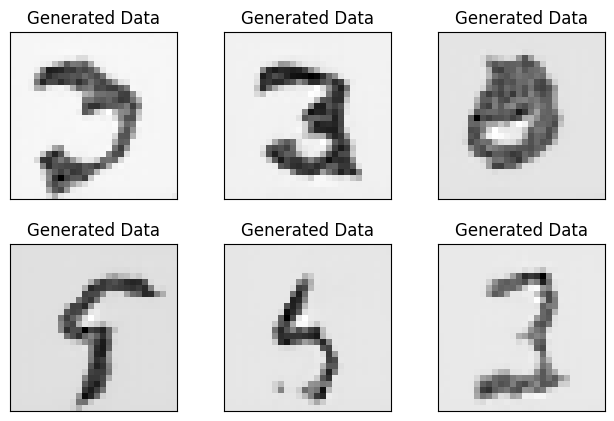

epoch 27


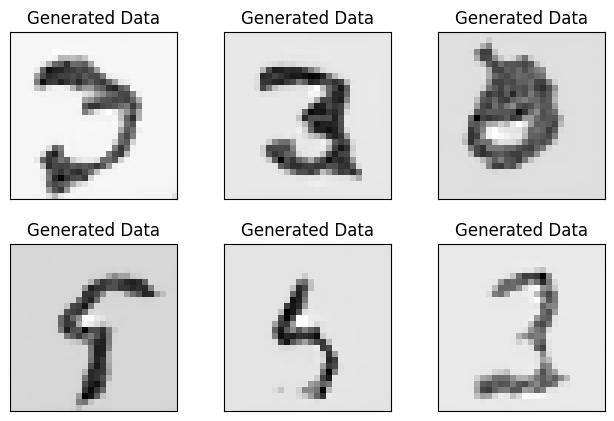

epoch 28


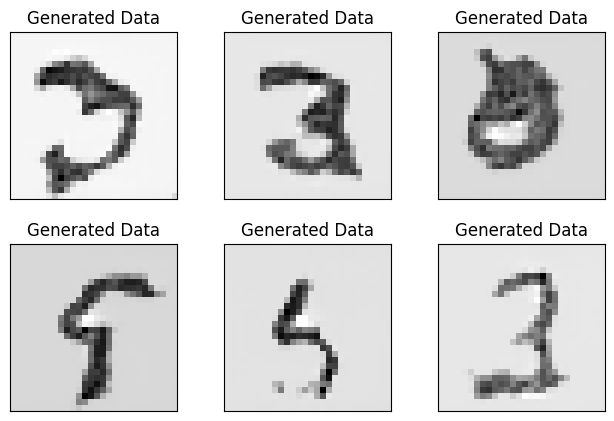

epoch 29


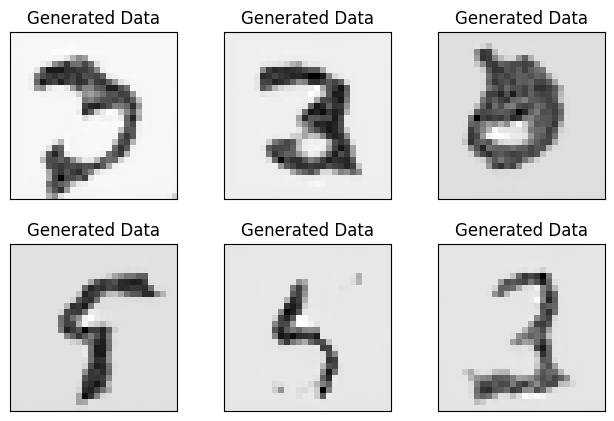

epoch 30


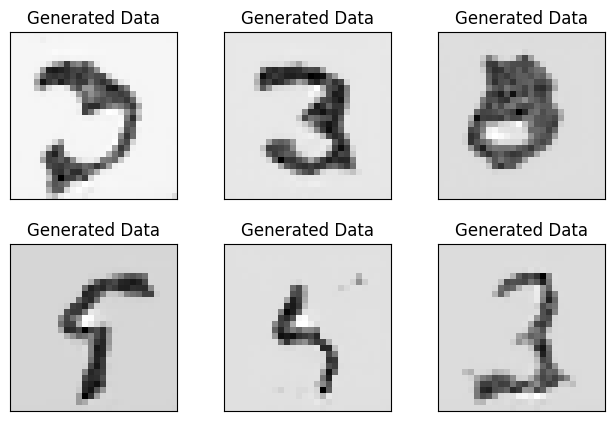

epoch 31


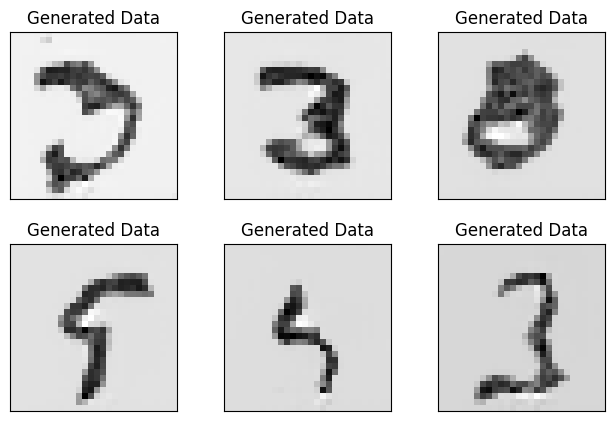

epoch 32


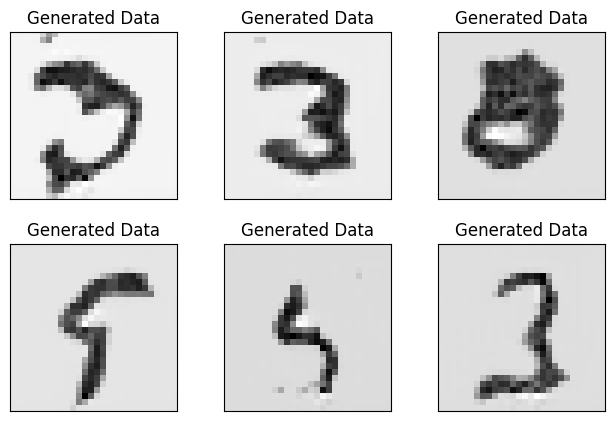

epoch 33


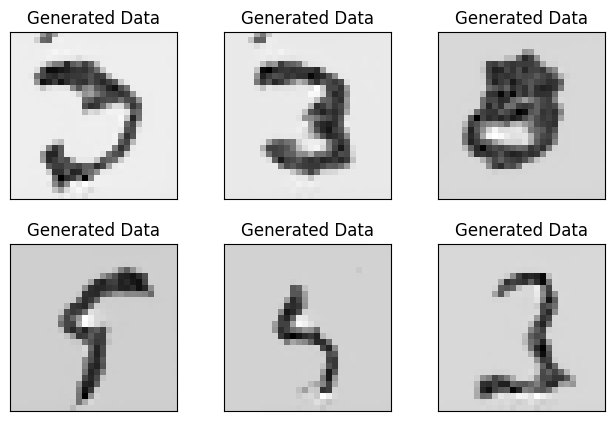

epoch 34


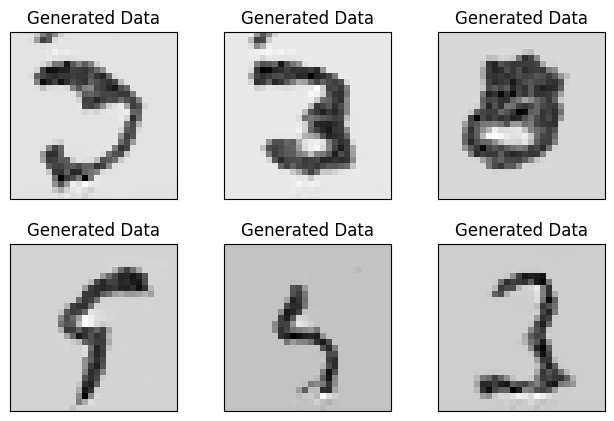

epoch 35


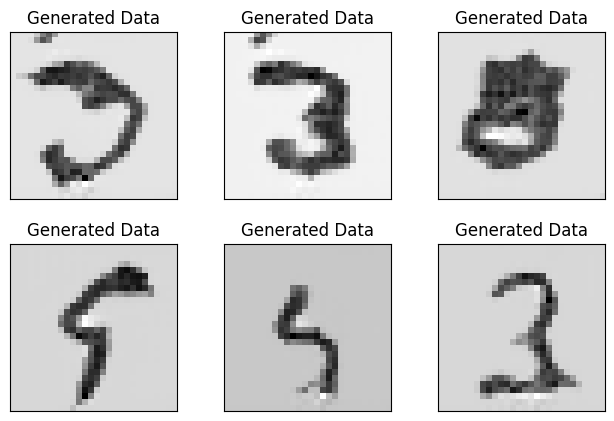

epoch 36


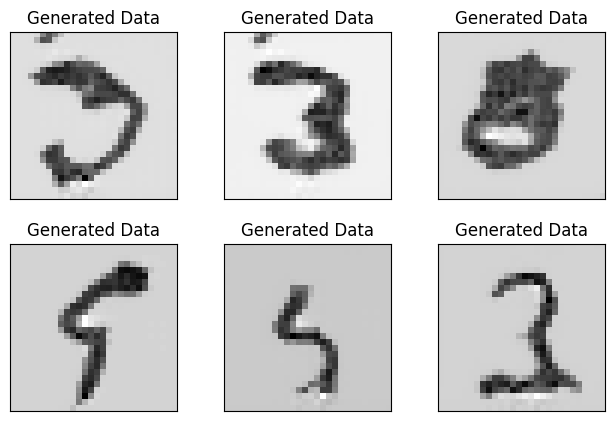

epoch 37


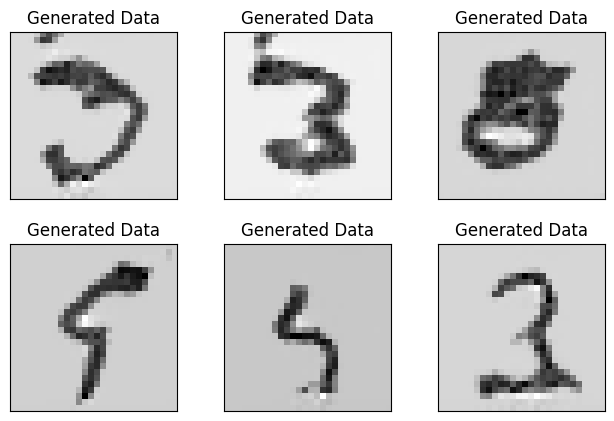

epoch 38


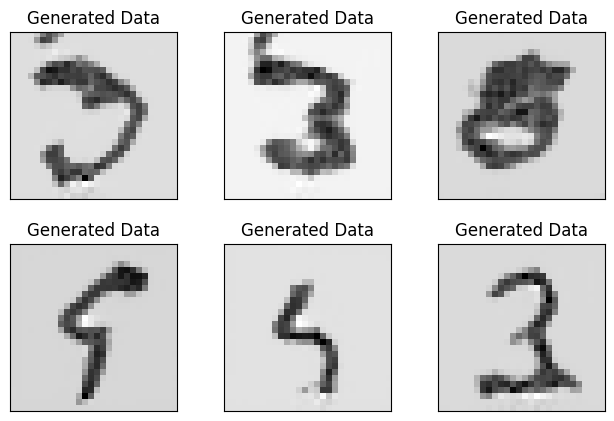

epoch 39


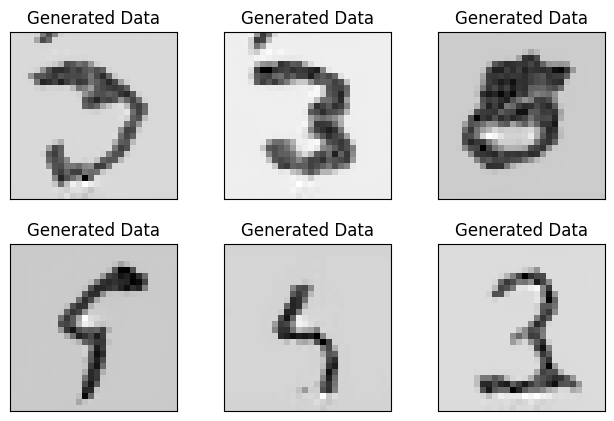

epoch 40


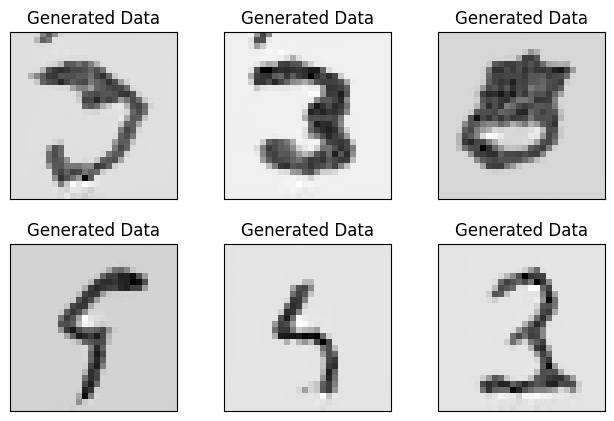

epoch 41


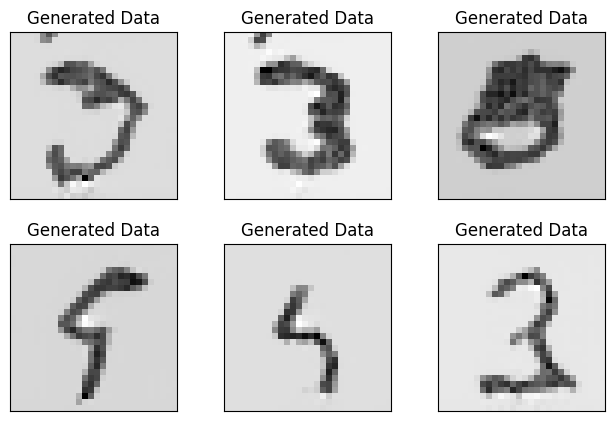

epoch 42


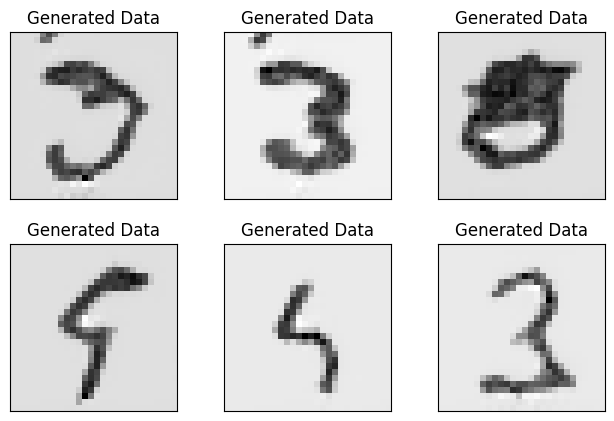

epoch 43


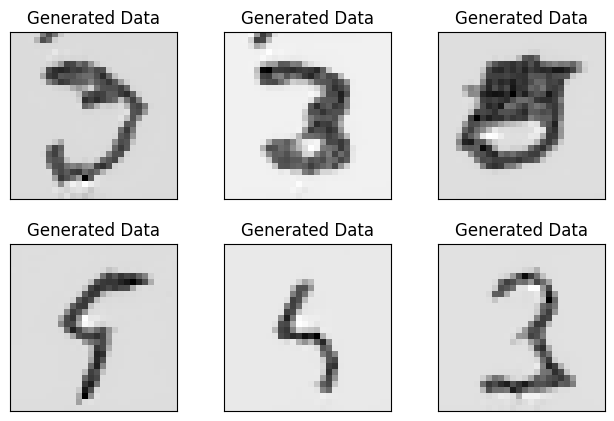

epoch 44


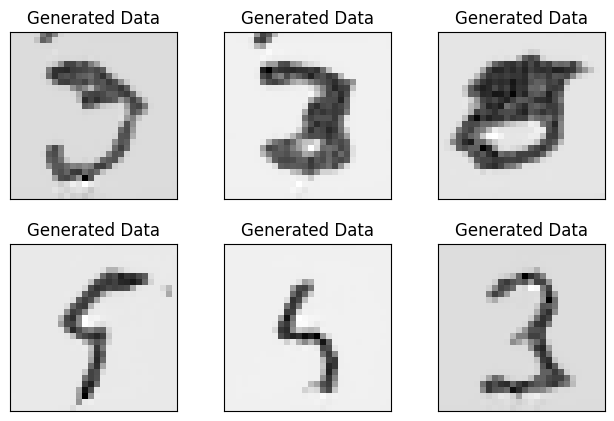

epoch 45


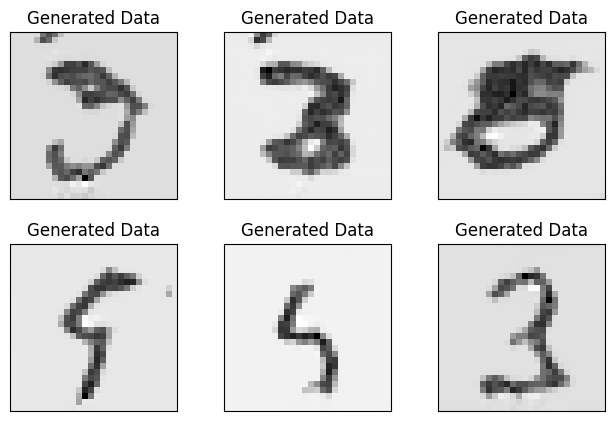

epoch 46


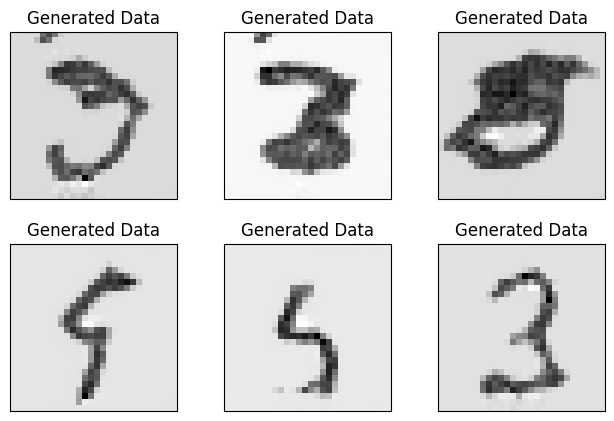

epoch 47


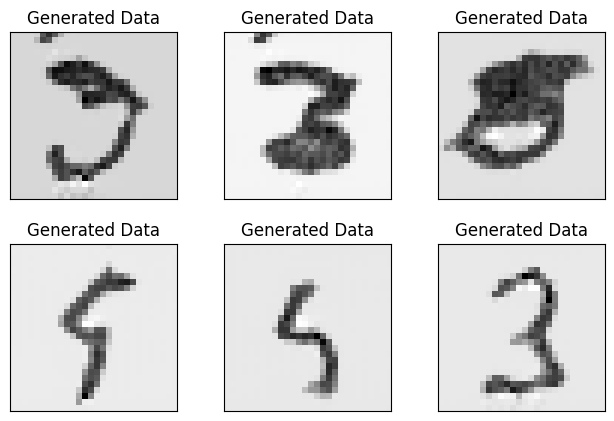

epoch 48


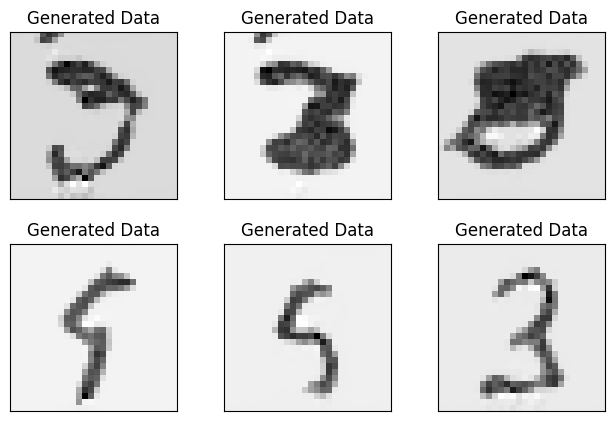

epoch 49


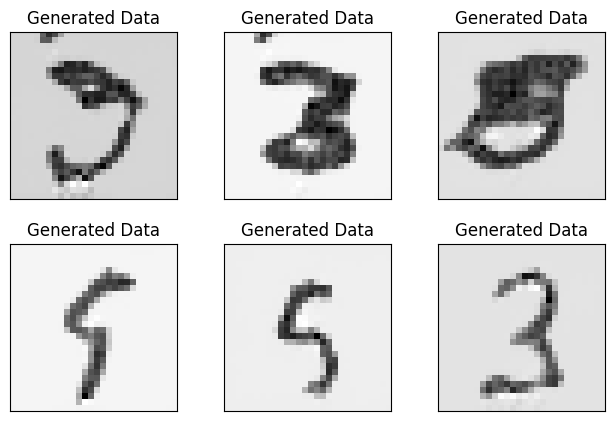

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


In [ ]:
trainer = pl.Trainer(max_epochs=50, devices=AVAIL_GPUS)
trainer.fit(model, dm)

## Cycle GAN

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.chdir('/content/drive/MyDrive/GANs')


In [ ]:
import os
import torch
from torch.utils.data import DataLoader
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import matplotlib.pyplot as plt

from helper import save_samples, checkpoint

# visualizing data
import matplotlib.pyplot as plt
import numpy as np
import warnings

%matplotlib inline

In [ ]:

def get_data_loader(image_type, image_dir='/content/drive/MyDrive/GANs/pytorch-CycleGAN-and-pix2pix/datasets/dataset_gan/real2oil',
                    image_size=128, batch_size=16, num_workers=0):

    # resize and normalize the images
    transform = transforms.Compose([transforms.Resize((image_size, image_size)), # resize to 128x128
                                    transforms.ToTensor()])

    # get training and test directories
    image_path = '' + image_dir
    train_path = os.path.join(image_path, image_type)
    test_path = os.path.join(image_path, 'test_{}'.format(image_type))

    # define datasets using ImageFolder
    train_dataset = datasets.ImageFolder(train_path, transform)
    test_dataset = datasets.ImageFolder(test_path, transform)

    # create and return DataLoaders
    train_loader = DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)
    test_loader = DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)

    return train_loader, test_loader

In [ ]:
# Create train and test dataloaders for images from the two domains X and Y
# image_type = directory names for our data
dataloader_X, test_dataloader_X = get_data_loader(image_type='oil')
dataloader_Y, test_dataloader_Y = get_data_loader(image_type='real')

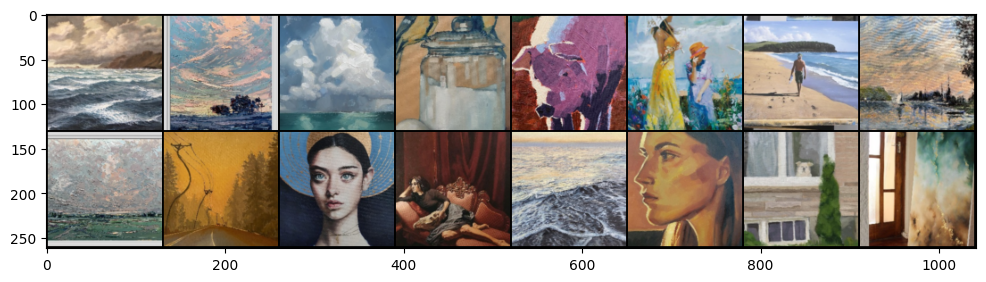

In [ ]:
# helper imshow function
def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))


# get some images from X
dataiter = iter(dataloader_X)
# the "_" is a placeholder for no labels
images, _ = next(iter(dataloader_X))

# show images
fig = plt.figure(figsize=(12, 8))
imshow(torchvision.utils.make_grid(images))

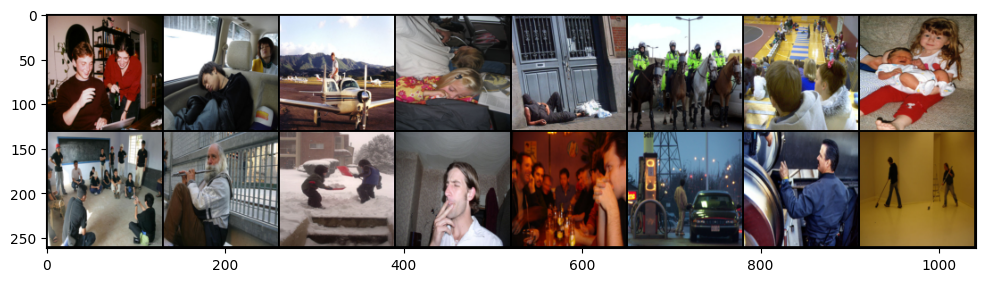

In [ ]:
dataiter = iter(dataloader_Y)
images, _ = next(iter(dataloader_Y))

# show images
fig = plt.figure(figsize=(12,8))
imshow(torchvision.utils.make_grid(images))

In [ ]:
img = images[0]

print('Min: ', img.min())

print('Max: ', img.max())

Min:  tensor(0.)
Max:  tensor(0.9098)


In [ ]:

def scale(x, feature_range=(-1, 1)):
    ''' Scale takes in an image x and returns that image, scaled
       with a feature_range of pixel values from -1 to 1.
       This function assumes that the input x is already scaled from 0-255.'''

    # scale from 0-1 to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [ ]:
scaled_img = scale(img)

print('Scaled min: ', scaled_img.min())
print('Scaled max: ', scaled_img.max())

Scaled min:  tensor(-1.)
Scaled max:  tensor(0.8196)


### discriminator



In [ ]:
# helper conv function
def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a convolutional layer, with optional batch normalization.
    """
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels,
                           kernel_size=kernel_size, stride=stride, padding=padding, bias=False)

    layers.append(conv_layer)

    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    return nn.Sequential(*layers)

In [ ]:
class Discriminator(nn.Module):

    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()

        # Define all convolutional layers
        # Should accept an RGB image as input and output a single value
        self.conv1 = conv(3, conv_dim, 4)
        self.conv2 = conv(conv_dim, conv_dim*2, 4, batch_norm=False)
        self.conv3 = conv(conv_dim*2, conv_dim*4, 4)
        self.conv4 = conv(conv_dim*4, conv_dim*8, 4)
        self.conv5 = conv(conv_dim*8, 1, 4, stride=1, batch_norm=False)

    def forward(self, x):
        # define feedforward behavior
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = self.conv5(x)

        return x

### generator

In [ ]:
# residual block class
class ResidualBlock(nn.Module):
    """Defines a residual block.
       This adds an input x to a convolutional layer (applied to x) with the same size input and output.
       These blocks allow a model to learn an effective transformation from one domain to another.
    """
    def __init__(self, conv_dim):
        super(ResidualBlock, self).__init__()
        # conv_dim = number of inputs

        # define two convolutional layers + batch normalization that will act as our residual function, F(x)
        # layers should have the same shape input as output; I suggest a kernel_size of 3
        self.conv1 = conv(conv_dim, conv_dim, kernel_size=3, stride=1, padding=1, batch_norm=True)
        self.conv2 = conv(conv_dim, conv_dim, kernel_size=3, stride=1, padding=1, batch_norm=True)

    def forward(self, x):
        # apply a ReLu activation the outputs of the first layer
        # return a summed output, x + resnet_block(x)

        out = F.relu(self.conv1(x))
        out = F.relu(self.conv2(out)) + x

        return out

In [ ]:
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a transpose convolutional layer, with optional batch normalization.
    """
    layers = []
    # append transpose conv layer
    layers.append(nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False))
    # optional batch norm layer
    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    return nn.Sequential(*layers)

In [ ]:
class CycleGenerator(nn.Module):

    def __init__(self, conv_dim=64, n_res_blocks=6):
        super(CycleGenerator, self).__init__()

        # 1. Define the encoder part of the generator
        self.conv1 = conv(3, conv_dim, 4)
        self.conv2 = conv(conv_dim, conv_dim*2, 4)
        self.conv3 = conv(conv_dim*2, conv_dim*4, 4)

        # 2. Define the resnet part of the generator
        res_layers = []
        for layer in range(n_res_blocks):
            res_layers.append(ResidualBlock(conv_dim*4))

        self.res_blocks = nn.Sequential(*res_layers)

        # 3. Define the decoder part of the generator
        self.deconv1 = deconv(conv_dim*4, conv_dim*2, 4)
        self.deconv2 = deconv(conv_dim*2, conv_dim, 4)
        self.deconv3 = deconv(conv_dim, 3, 4, batch_norm=False)

    def forward(self, x):
        """Given an image x, returns a transformed image."""
        # define feedforward behavior, applying activations as necessary
        out = F.relu(self.conv1(x))
        out = F.relu(self.conv2(out))
        out = F.relu(self.conv3(out))

        out = self.res_blocks(out)

        out = F.relu(self.deconv1(out))
        out = F.relu(self.deconv2(out))
        out = F.tanh(self.deconv3(out))

        return out

In [ ]:
def create_model(g_conv_dim=64, d_conv_dim=64, n_res_blocks=6):
    """Builds the generators and discriminators."""

    # Instantiate generators
    G_XtoY = CycleGenerator(g_conv_dim, n_res_blocks)
    G_YtoX = CycleGenerator(g_conv_dim, n_res_blocks)

    # Instantiate discriminators
    D_X = Discriminator(d_conv_dim)
    D_Y = Discriminator(d_conv_dim)

    # move models to GPU, if available
    if torch.cuda.is_available():
        device = torch.device("cuda:0")
        G_XtoY.to(device)
        G_YtoX.to(device)
        D_X.to(device)
        D_Y.to(device)
        print('Models moved to GPU.')
    else:
        print('Only CPU available.')

    return G_XtoY, G_YtoX, D_X, D_Y

In [ ]:
G_XtoY, G_YtoX, D_X, D_Y = create_model()

Models moved to GPU.


In [ ]:
def print_models(G_XtoY, G_YtoX, D_X, D_Y):
    """Prints model information for the generators and discriminators.
    """
    print("                     G_XtoY                    ")
    print("-----------------------------------------------")
    print(G_XtoY)
    print()

    print("                     G_YtoX                    ")
    print("-----------------------------------------------")
    print(G_YtoX)
    print()

    print("                      D_X                      ")
    print("-----------------------------------------------")
    print(D_X)
    print()

    print("                      D_Y                      ")
    print("-----------------------------------------------")
    print(D_Y)
    print()


# print all of the models
print_models(G_XtoY, G_YtoX, D_X, D_Y)


                     G_XtoY                    
-----------------------------------------------
CycleGenerator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (res_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
 

In [ ]:
def real_mse_loss(D_out):
    # how close is the produced output from being "real"?
    return torch.mean((D_out-1)**2)

def fake_mse_loss(D_out):
    # how close is the produced output from being "false"?
    return torch.mean(D_out**2)

def cycle_consistency_loss(real_im, reconstructed_im, lambda_weight):
    # calculate reconstruction loss
    # return weighted loss
    recon_loss = torch.mean(torch.abs(real_im - reconstructed_im))

    return lambda_weight*recon_loss

In [ ]:
# hyperparams for Adam optimizers
lr = 0.0002
beta1 = 0.5
beta2 = 0.999

g_params = list(G_XtoY.parameters()) + list(G_YtoX.parameters())  # Get generator parameters

# Create optimizers for the generators and discriminators
g_optimizer = optim.Adam(g_params, lr, [beta1, beta2])
d_x_optimizer = optim.Adam(D_X.parameters(), lr, [beta1, beta2])
d_y_optimizer = optim.Adam(D_Y.parameters(), lr, [beta1, beta2])

In [ ]:
def training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y,
                  n_epochs=1000):

    print_every = 100
    sample_every = 100
    # checkpoint_every = 1000  # Uncomment if using checkpointing

    # keep track of losses over time
    losses = []

    # Get some fixed data from domains X and Y for consistent sample generation
    fixed_X = next(iter(test_dataloader_X))[0]
    fixed_Y = next(iter(test_dataloader_Y))[0]
    fixed_X = scale(fixed_X)  # scale to range -1 to 1
    fixed_Y = scale(fixed_Y)

    for epoch in range(1, n_epochs + 1):
        # Reset iterators
        iter_X = iter(dataloader_X)
        iter_Y = iter(dataloader_Y)

        # Ensure batches are synced
        batches_per_epoch = min(len(dataloader_X), len(dataloader_Y))

        for _ in range(batches_per_epoch):
            images_X, _ = next(iter_X)
            images_Y, _ = next(iter_Y)

            images_X = scale(images_X)
            images_Y = scale(images_Y)

            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
            images_X = images_X.to(device)
            images_Y = images_Y.to(device)

            # ================================
            #   TRAIN THE DISCRIMINATORS
            # ================================

            # --- D_X ---
            d_x_optimizer.zero_grad()

            out_x = D_X(images_X)
            D_X_real_loss = real_mse_loss(out_x)

            fake_X = G_YtoX(images_Y)
            D_X_fake_loss = fake_mse_loss(fake_X)

            d_x_loss = D_X_real_loss + D_X_fake_loss
            d_x_loss.backward()
            d_x_optimizer.step()

            # --- D_Y ---
            d_y_optimizer.zero_grad()

            out_y = D_Y(images_Y)
            D_Y_real_loss = real_mse_loss(out_y)

            fake_Y = G_XtoY(images_X)
            D_Y_fake_loss = fake_mse_loss(fake_Y)

            d_y_loss = D_Y_real_loss + D_Y_fake_loss
            d_y_loss.backward()
            d_y_optimizer.step()

            # ============================
            #     TRAIN THE GENERATORS
            # ============================

            g_optimizer.zero_grad()

            # --- G_YtoX + Cycle Y->X->Y ---
            fake_X = G_YtoX(images_Y)
            out_x = D_X(fake_X)
            g_YtoX_loss = real_mse_loss(out_x)

            recon_Y = G_XtoY(fake_X)
            recon_Y_loss = cycle_consistency_loss(images_Y, recon_Y, lambda_weight=10)

            # --- G_XtoY + Cycle X->Y->X ---
            fake_Y = G_XtoY(images_X)
            out_y = D_Y(fake_Y)
            g_XtoY_loss = real_mse_loss(out_y)

            recon_X = G_YtoX(fake_Y)
            recon_X_loss = cycle_consistency_loss(images_X, recon_X, lambda_weight=10)

            # Total Generator Loss
            g_total_loss = g_XtoY_loss + g_YtoX_loss + recon_X_loss + recon_Y_loss
            g_total_loss.backward()
            g_optimizer.step()

        # Logging
        if epoch % print_every == 0:
            losses.append((d_x_loss.item(), d_y_loss.item(), g_total_loss.item()))
            print('Epoch [{:5d}/{:5d}] | d_X_loss: {:6.4f} | d_Y_loss: {:6.4f} | g_total_loss: {:6.4f}'.format(
                epoch, n_epochs, d_x_loss.item(), d_y_loss.item(), g_total_loss.item()))

        # Sampling
        if epoch % sample_every == 0:
            G_YtoX.eval()
            G_XtoY.eval()
            save_samples(epoch, fixed_Y, fixed_X, G_YtoX, G_XtoY, batch_size=16)
            G_YtoX.train()
            G_XtoY.train()

        # # Checkpointing (optional)
        # if epoch % checkpoint_every == 0:
        #     checkpoint(epoch, G_XtoY, G_YtoX, D_X, D_Y)

    return losses


In [ ]:
def rescale_for_plot(x):
    """Rescales from [-1, 1] to [0, 1] for plotting."""
    return (x + 1) / 2.0

def plot_samples(epoch, fixed_Y, fixed_X, G_YtoX, G_XtoY, batch_size=6):
    device = next(G_YtoX.parameters()).device

    fixed_Y = fixed_Y.to(device)[:batch_size]
    fixed_X = fixed_X.to(device)[:batch_size]

    with torch.no_grad():
        fake_X = G_YtoX(fixed_Y)
        fake_Y = G_XtoY(fixed_X)

    # Move tensors to CPU and rescale from [-1, 1] to [0, 1]
    fixed_Y = rescale_for_plot(fixed_Y.cpu())
    fake_X = rescale_for_plot(fake_X.cpu())
    fixed_X = rescale_for_plot(fixed_X.cpu())
    fake_Y = rescale_for_plot(fake_Y.cpu())

    fig, axs = plt.subplots(4, batch_size, figsize=(batch_size * 2, 8))

    for i in range(batch_size):
        axs[0, i].imshow(fixed_X[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[0, i].set_title("Real X")
        axs[0, i].axis('off')

        axs[1, i].imshow(fake_Y[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[1, i].set_title("Fake Y")
        axs[1, i].axis('off')

        axs[2, i].imshow(fixed_Y[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[2, i].set_title("Real Y")
        axs[2, i].axis('off')

        axs[3, i].imshow(fake_X[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[3, i].set_title("Fake X")
        axs[3, i].axis('off')

    plt.suptitle(f"Epoch {epoch}")
    plt.tight_layout()
    plt.show()


In [ ]:
import matplotlib.pyplot as plt
import torch

def plot_samples(epoch, fixed_Y, fixed_X, G_YtoX, G_XtoY, batch_size=6):
    device = next(G_YtoX.parameters()).device

    fixed_Y = fixed_Y.to(device)[:batch_size]
    fixed_X = fixed_X.to(device)[:batch_size]

    with torch.no_grad():
        fake_X = G_YtoX(fixed_Y)
        fake_Y = G_XtoY(fixed_X)

    fixed_Y = fixed_Y.cpu()
    fake_X = fake_X.cpu()
    fixed_X = fixed_X.cpu()
    fake_Y = fake_Y.cpu()

    fig, axs = plt.subplots(4, batch_size, figsize=(batch_size * 2, 8))

    for i in range(batch_size):
        axs[0, i].imshow(fixed_X[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[0, i].set_title("Real X")
        axs[0, i].axis('off')

        axs[1, i].imshow(fake_Y[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[1, i].set_title("Fake Y")
        axs[1, i].axis('off')

        axs[2, i].imshow(fixed_Y[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[2, i].set_title("Real Y")
        axs[2, i].axis('off')

        axs[3, i].imshow(fake_X[i].permute(1, 2, 0).squeeze(), cmap='gray')
        axs[3, i].set_title("Fake X")
        axs[3, i].axis('off')

    plt.suptitle(f"Epoch {epoch}")
    plt.tight_layout()
    plt.show()


In [ ]:
def training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y,
                  n_epochs=1000):

    print_every = 100
    sample_every = 100
    losses = []

    fixed_X = next(iter(test_dataloader_X))[0]
    fixed_Y = next(iter(test_dataloader_Y))[0]
    fixed_X = scale(fixed_X)
    fixed_Y = scale(fixed_Y)

    for epoch in range(1, n_epochs + 1):
        iter_X = iter(dataloader_X)
        iter_Y = iter(dataloader_Y)

        batches_per_epoch = min(len(dataloader_X), len(dataloader_Y))

        for _ in range(batches_per_epoch):
            images_X, _ = next(iter_X)
            images_Y, _ = next(iter_Y)

            images_X = scale(images_X)
            images_Y = scale(images_Y)

            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
            images_X = images_X.to(device)
            images_Y = images_Y.to(device)

            # ================================
            #   TRAIN THE DISCRIMINATORS
            # ================================

            # --- D_X ---
            d_x_optimizer.zero_grad()

            out_x = D_X(images_X)
            D_X_real_loss = real_mse_loss(out_x)

            fake_X = G_YtoX(images_Y)
            D_X_fake_loss = fake_mse_loss(fake_X)

            d_x_loss = D_X_real_loss + D_X_fake_loss
            d_x_loss.backward()
            d_x_optimizer.step()

            # --- D_Y ---
            d_y_optimizer.zero_grad()

            out_y = D_Y(images_Y)
            D_Y_real_loss = real_mse_loss(out_y)

            fake_Y = G_XtoY(images_X)
            D_Y_fake_loss = fake_mse_loss(fake_Y)

            d_y_loss = D_Y_real_loss + D_Y_fake_loss
            d_y_loss.backward()
            d_y_optimizer.step()

            # ============================
            #     TRAIN THE GENERATORS
            # ============================

            g_optimizer.zero_grad()

            # --- G_YtoX + Cycle Y->X->Y ---
            fake_X = G_YtoX(images_Y)
            out_x = D_X(fake_X)
            g_YtoX_loss = real_mse_loss(out_x)

            recon_Y = G_XtoY(fake_X)
            recon_Y_loss = cycle_consistency_loss(images_Y, recon_Y, lambda_weight=10)

            # --- G_XtoY + Cycle X->Y->X ---
            fake_Y = G_XtoY(images_X)
            out_y = D_Y(fake_Y)
            g_XtoY_loss = real_mse_loss(out_y)

            recon_X = G_YtoX(fake_Y)
            recon_X_loss = cycle_consistency_loss(images_X, recon_X, lambda_weight=10)

            # Total Generator Loss
            g_total_loss = g_XtoY_loss + g_YtoX_loss + recon_X_loss + recon_Y_loss
            g_total_loss.backward()
            g_optimizer.step()


        if epoch % print_every == 0:
            losses.append((d_x_loss.item(), d_y_loss.item(), g_total_loss.item()))
            print('Epoch [{:5d}/{:5d}] | d_X_loss: {:6.4f} | d_Y_loss: {:6.4f} | g_total_loss: {:6.4f}'.format(
                epoch, n_epochs, d_x_loss.item(), d_y_loss.item(), g_total_loss.item()))

        # Live plotting (no saving)
        if epoch % sample_every == 0:
            G_YtoX.eval()
            G_XtoY.eval()
            plot_samples(epoch, fixed_Y, fixed_X, G_YtoX, G_XtoY, batch_size=6)
            G_YtoX.train()
            G_XtoY.train()

    return losses


Epoch [  100/ 5000] | d_X_loss: 0.1380 | d_Y_loss: 0.2271 | g_total_loss: 3.4981


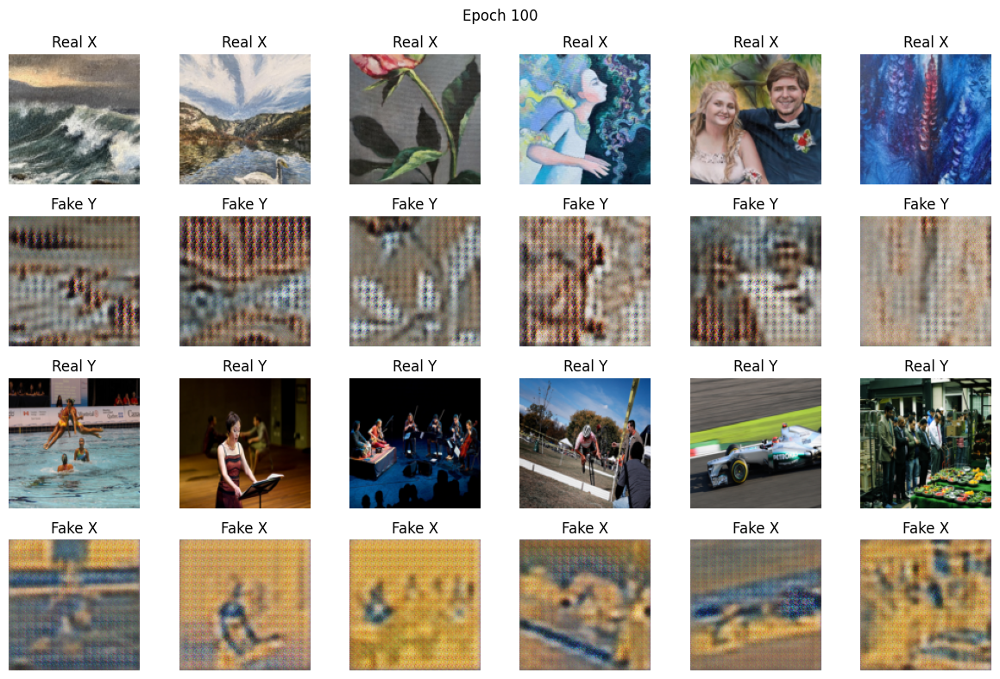

Epoch [  200/ 5000] | d_X_loss: 0.1544 | d_Y_loss: 0.2067 | g_total_loss: 3.7765


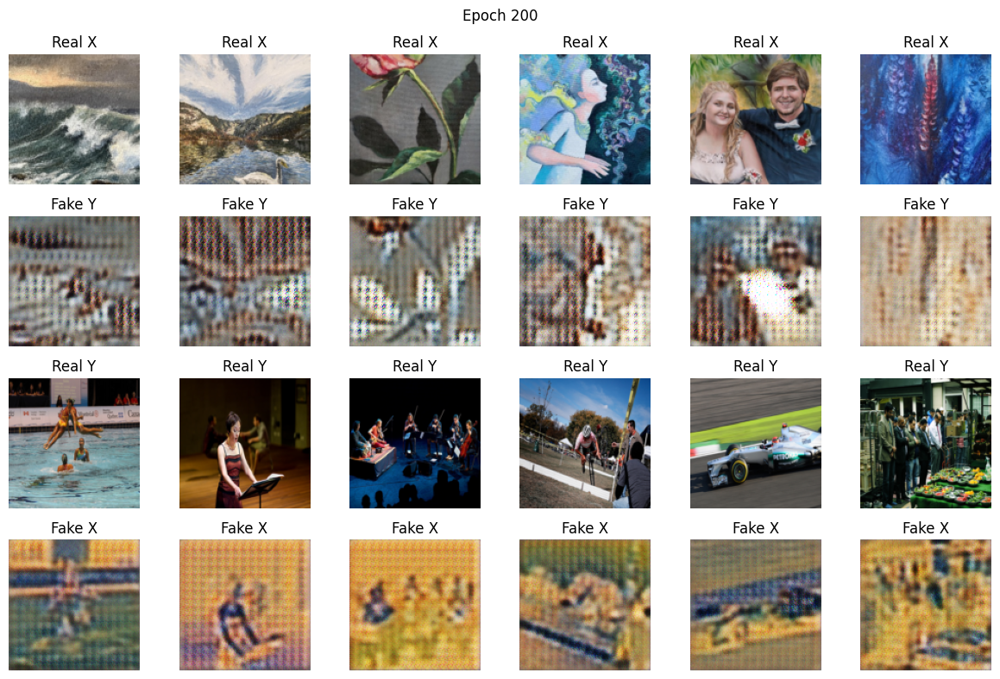

Epoch [  300/ 5000] | d_X_loss: 0.1460 | d_Y_loss: 0.2306 | g_total_loss: 2.6001


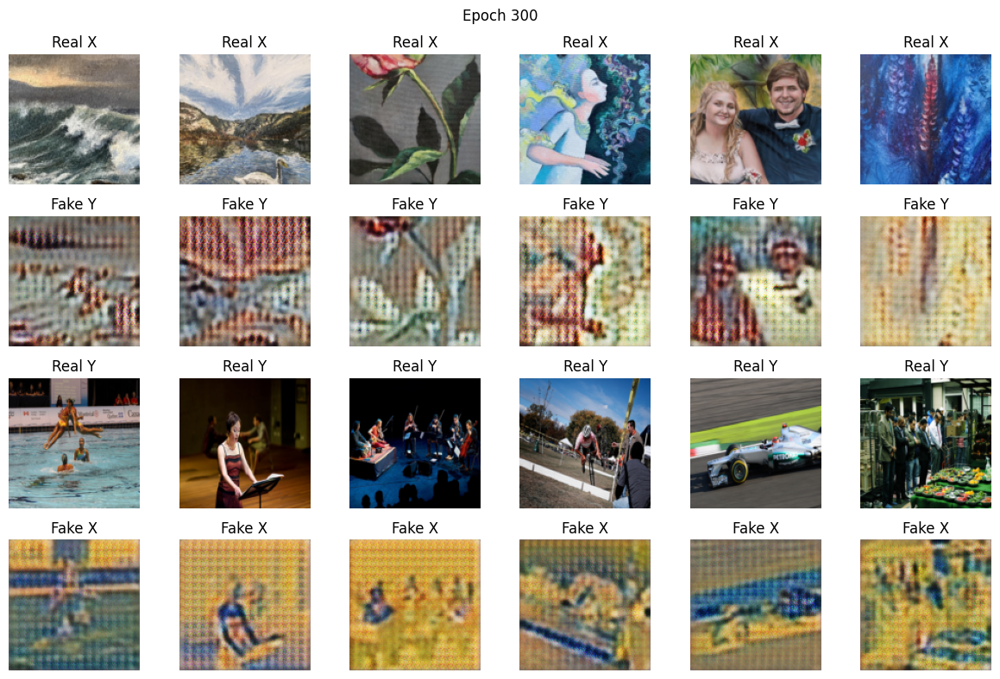

Epoch [  400/ 5000] | d_X_loss: 0.1509 | d_Y_loss: 0.2192 | g_total_loss: 2.7624


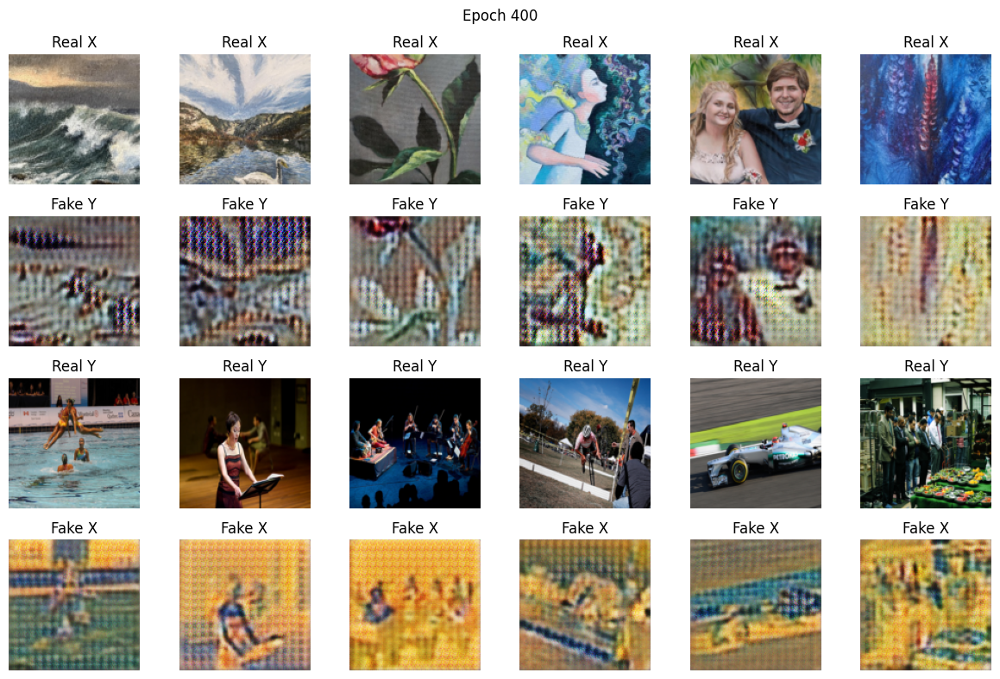

Epoch [  500/ 5000] | d_X_loss: 0.1294 | d_Y_loss: 0.1977 | g_total_loss: 3.6083


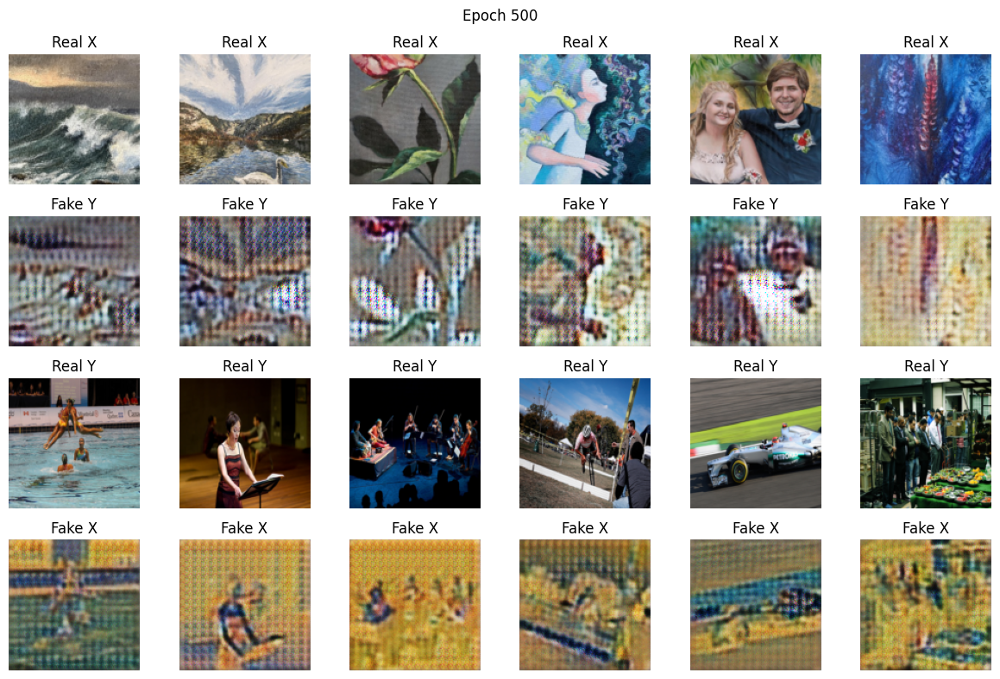

Epoch [  600/ 5000] | d_X_loss: 0.1506 | d_Y_loss: 0.1943 | g_total_loss: 2.4076


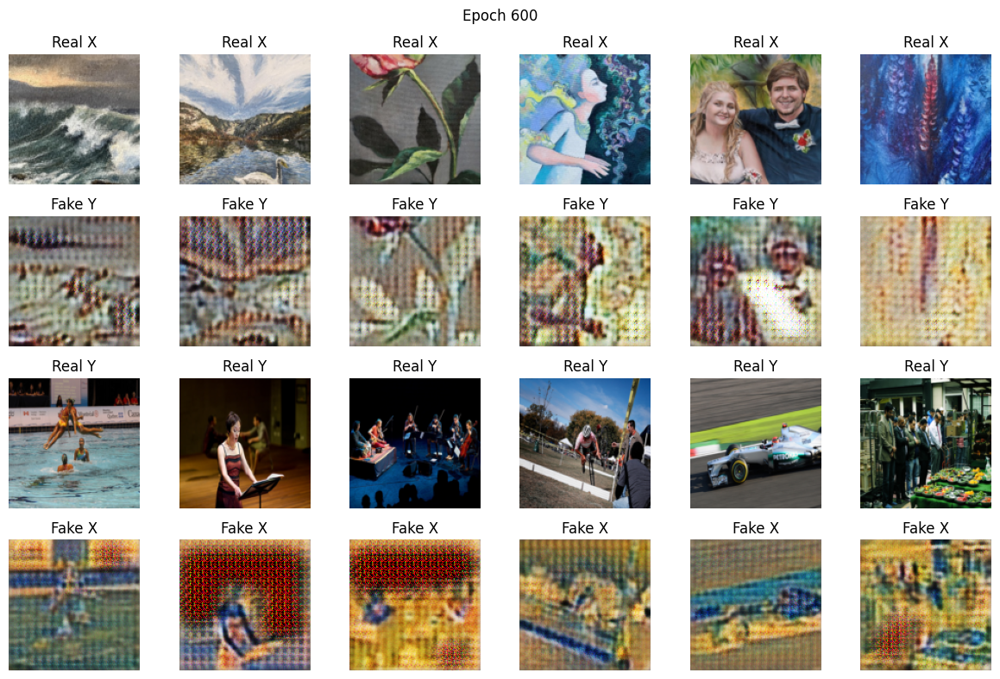

Epoch [  700/ 5000] | d_X_loss: 0.1403 | d_Y_loss: 0.2345 | g_total_loss: 2.5485


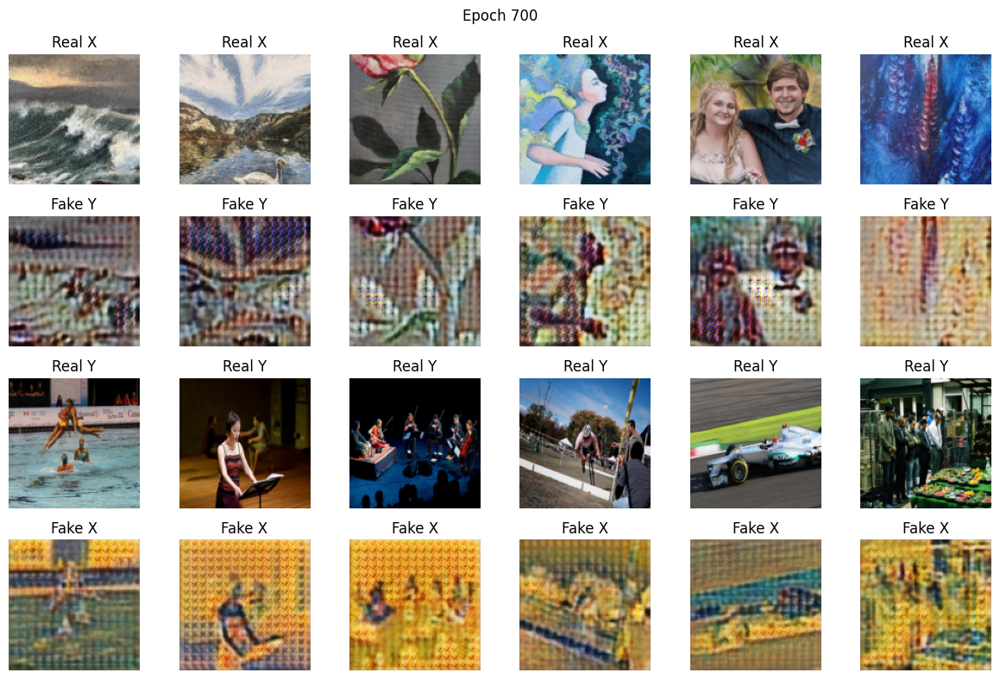

Epoch [  800/ 5000] | d_X_loss: 0.1332 | d_Y_loss: 0.2534 | g_total_loss: 2.5771


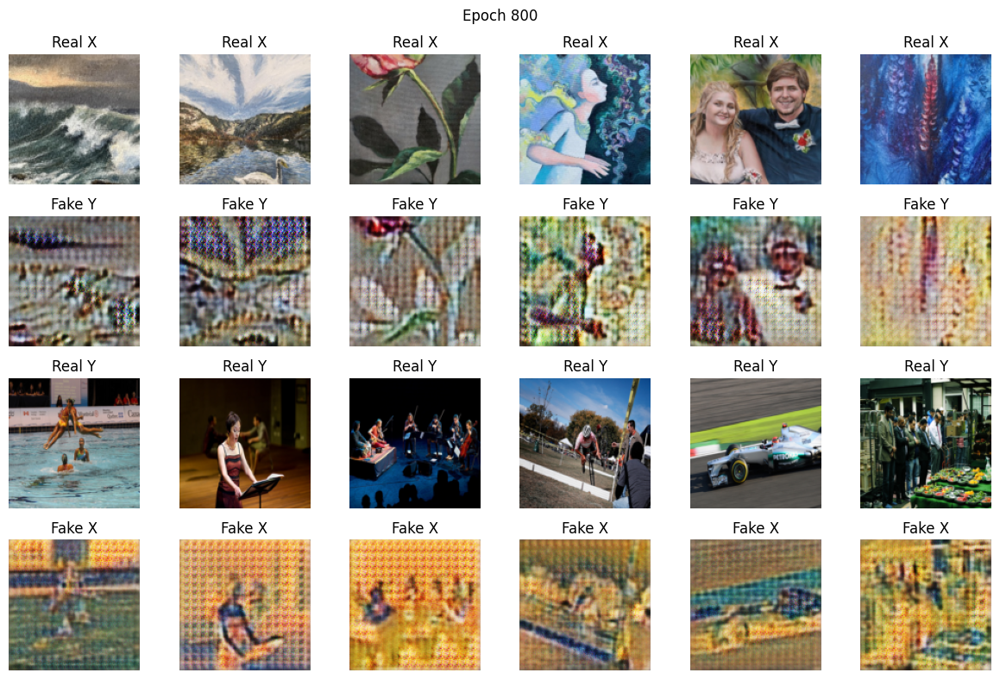

Epoch [  900/ 5000] | d_X_loss: 0.1437 | d_Y_loss: 0.1999 | g_total_loss: 1.5033


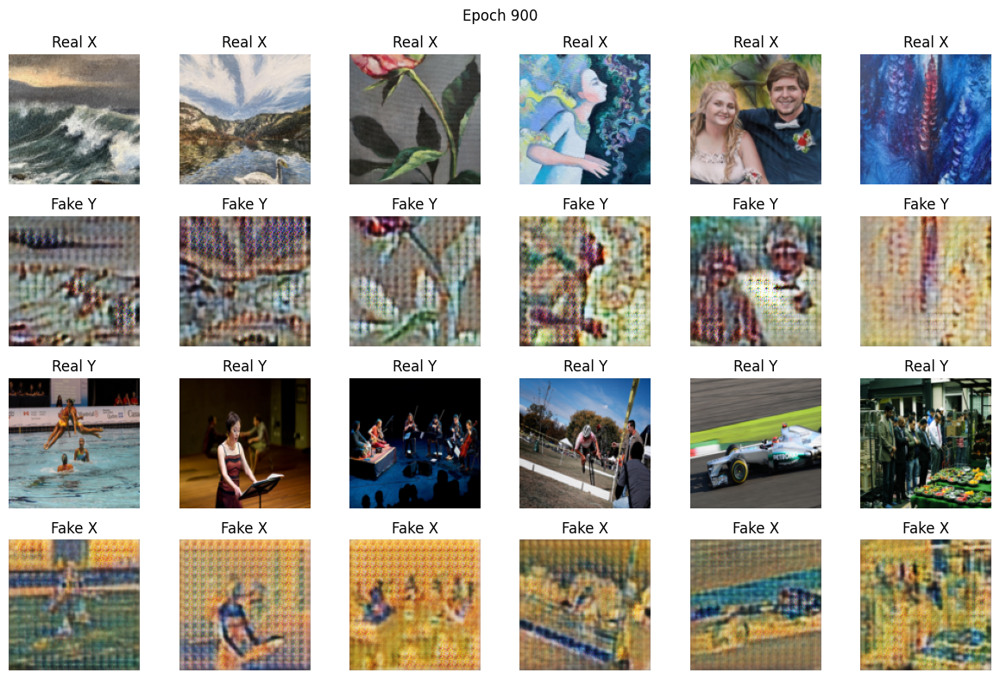

Epoch [ 1000/ 5000] | d_X_loss: 0.1353 | d_Y_loss: 0.1899 | g_total_loss: 1.8205


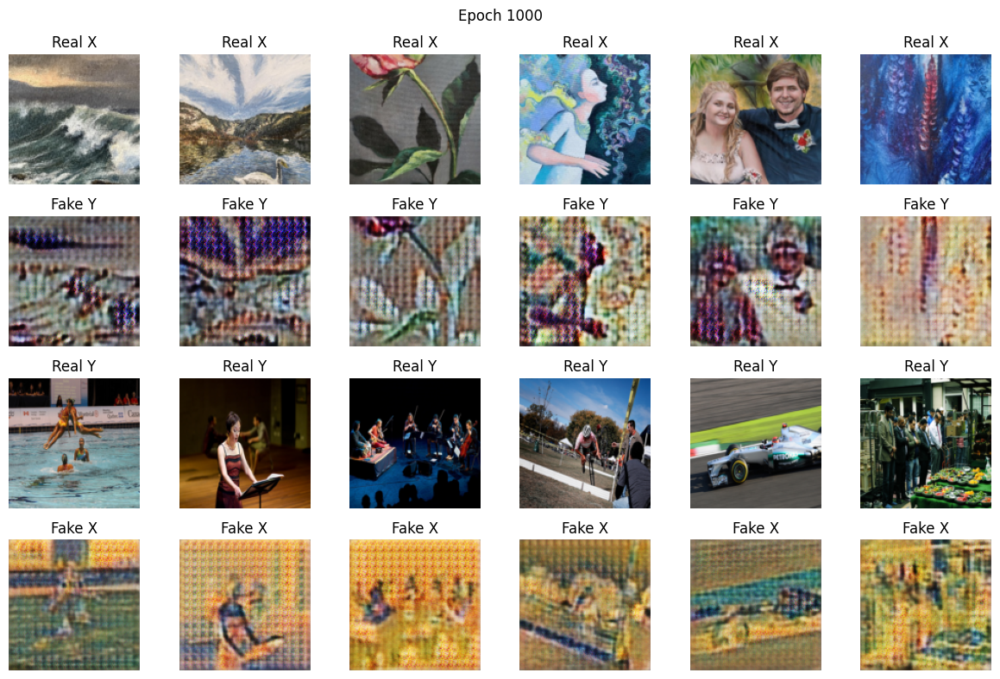

Epoch [ 1100/ 5000] | d_X_loss: 0.1383 | d_Y_loss: 0.2583 | g_total_loss: 1.5620


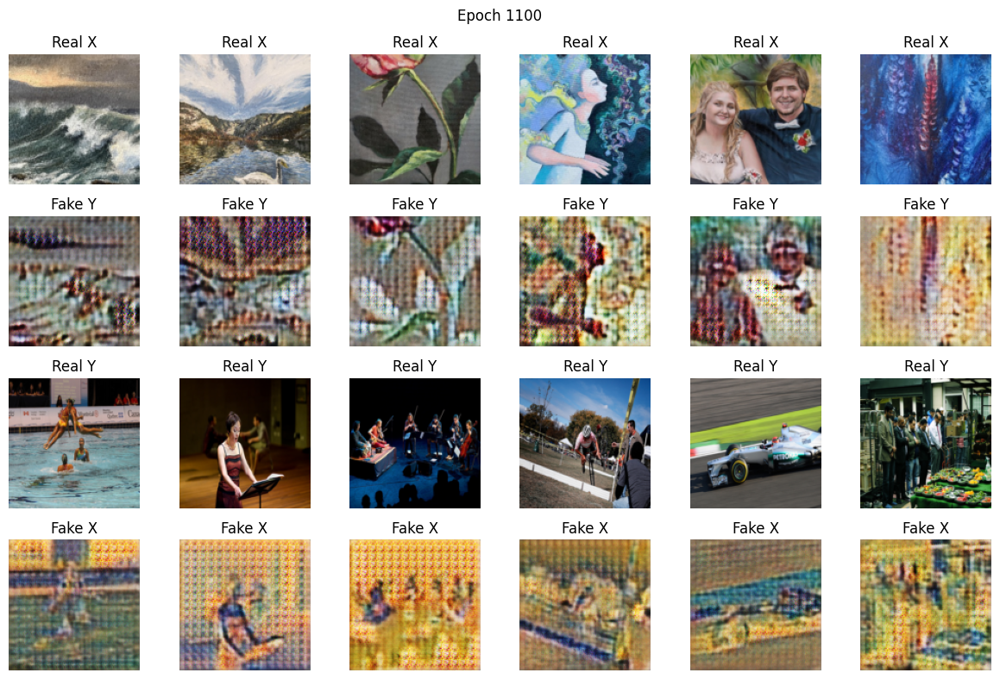

Epoch [ 1200/ 5000] | d_X_loss: 0.1364 | d_Y_loss: 0.2114 | g_total_loss: 2.7096


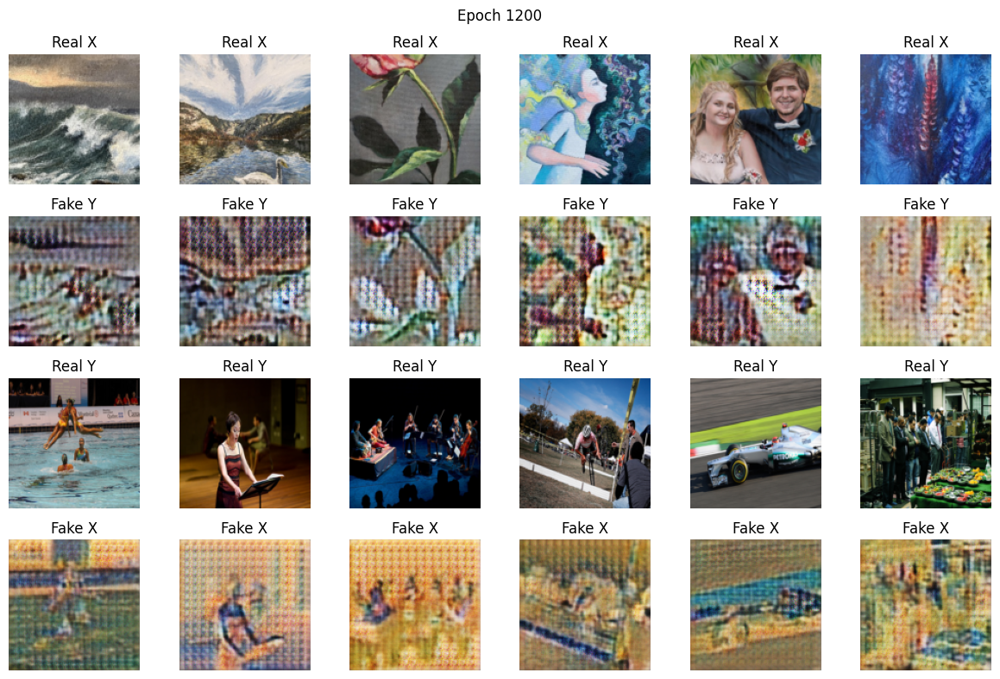

Epoch [ 1300/ 5000] | d_X_loss: 0.1314 | d_Y_loss: 0.2223 | g_total_loss: 1.6575


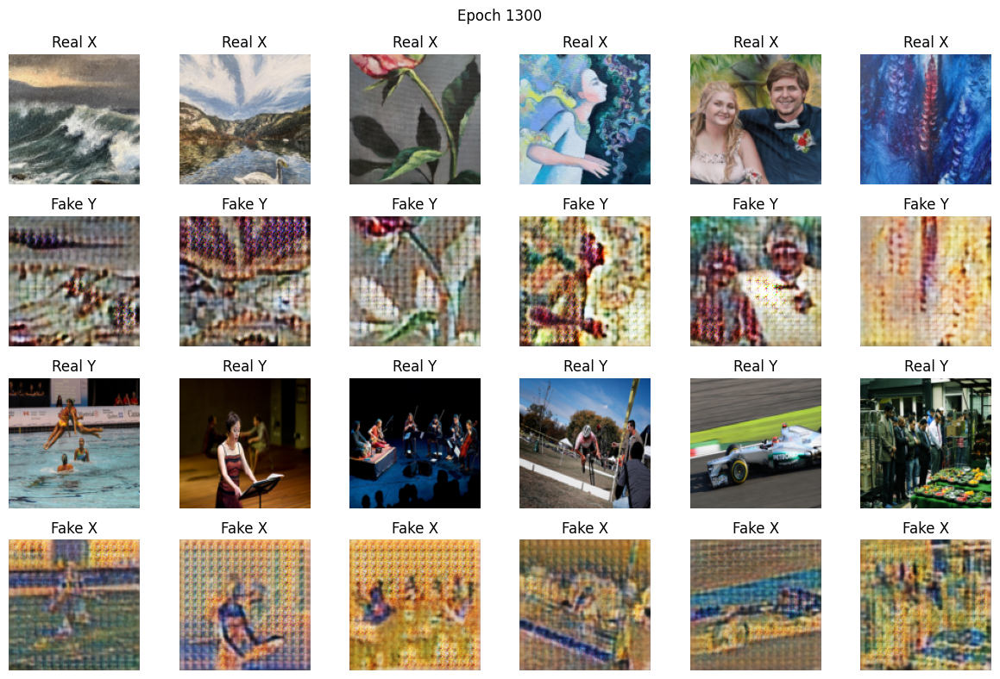

Epoch [ 1400/ 5000] | d_X_loss: 0.1244 | d_Y_loss: 0.2165 | g_total_loss: 1.4887


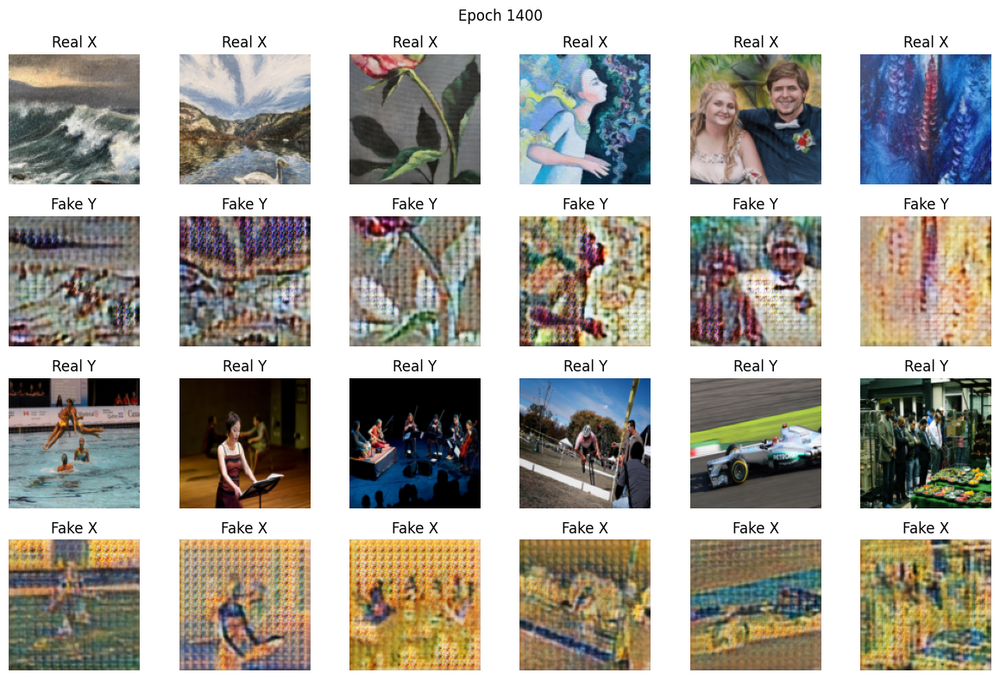

Epoch [ 1500/ 5000] | d_X_loss: 0.1184 | d_Y_loss: 0.2109 | g_total_loss: 1.6024


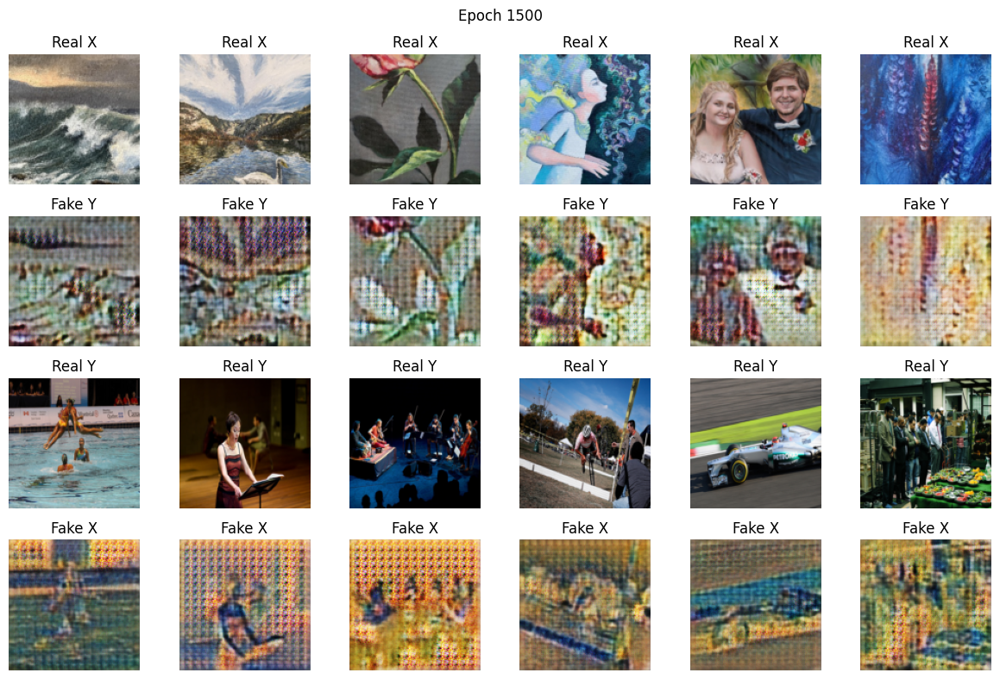

Epoch [ 1600/ 5000] | d_X_loss: 0.1233 | d_Y_loss: 0.2086 | g_total_loss: 1.7401


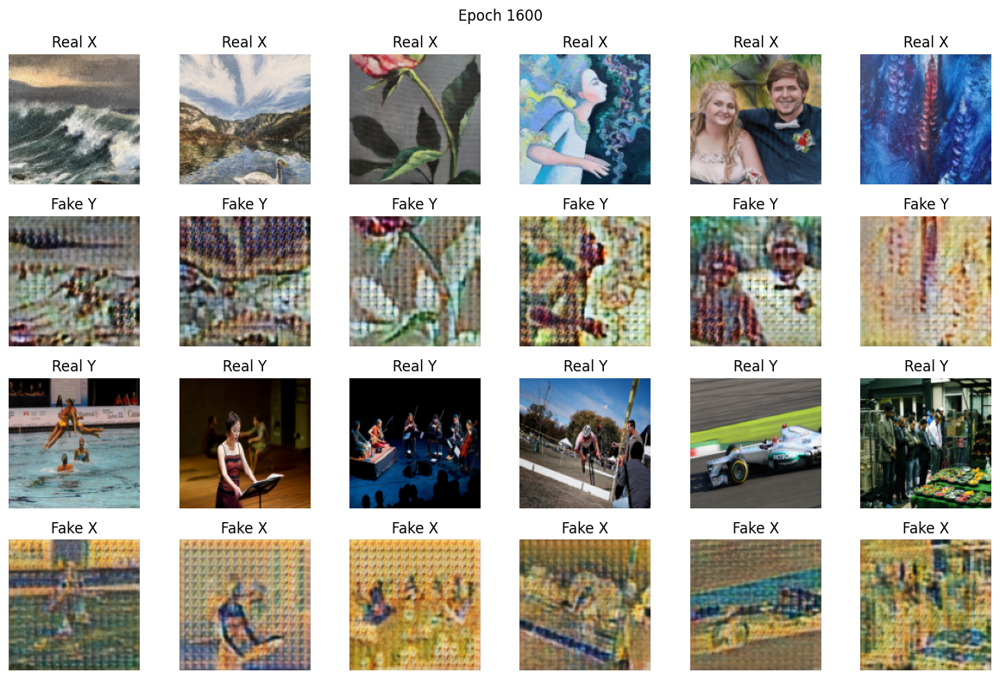

Epoch [ 1700/ 5000] | d_X_loss: 0.1395 | d_Y_loss: 0.2356 | g_total_loss: 1.2907


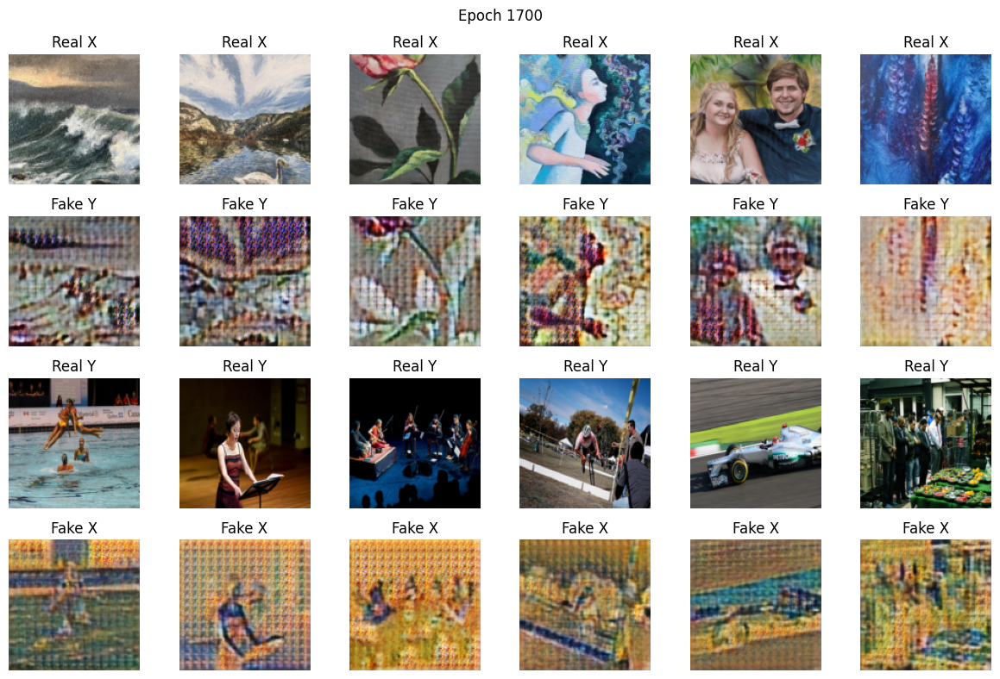

In [ ]:
n_epochs = 5000 # keep this small when testing if a model first works, then increase it to >=1000

losses = training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y, n_epochs=n_epochs)